<a href="https://colab.research.google.com/github/mike1simon/computer_vision_ai_club/blob/main/Computer_Vision_Intro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# What is Computer vision?

Computer vision is a field of artificial intelligence that focuses on enabling computers to interpret and understand visual data from the world around them, such as images and videos. This involves using specialized algorithms and models to process and analyze visual information in order to recognize objects, interpret scenes, and understand the content of images and videos. The ultimate goal of computer vision is to enable computers to "see" and understand the world in the same way that humans do, which has a wide range of applications in fields such as robotics, image and video analysis, and autonomous systems.

![image](https://github.com/mike1simon/computer_vision_ai_club/blob/main/slides_images/roadmap.jpg?raw=true)
source: [youtube: Making a Career in Computer Vision / AI](https://www.youtube.com/watch?v=R55__Dq2mVs)




## light and vision

![light_image](https://github.com/mike1simon/computer_vision_ai_club/blob/main/slides_images/light.png?raw=true)

In [147]:
!sudo rm -rf computer_vision_ai_club
!git clone https://github.com/mike1simon/computer_vision_ai_club.git

Cloning into 'computer_vision_ai_club'...
remote: Enumerating objects: 81, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 81 (delta 3), reused 0 (delta 0), pack-reused 64
Unpacking objects: 100% (81/81), done.


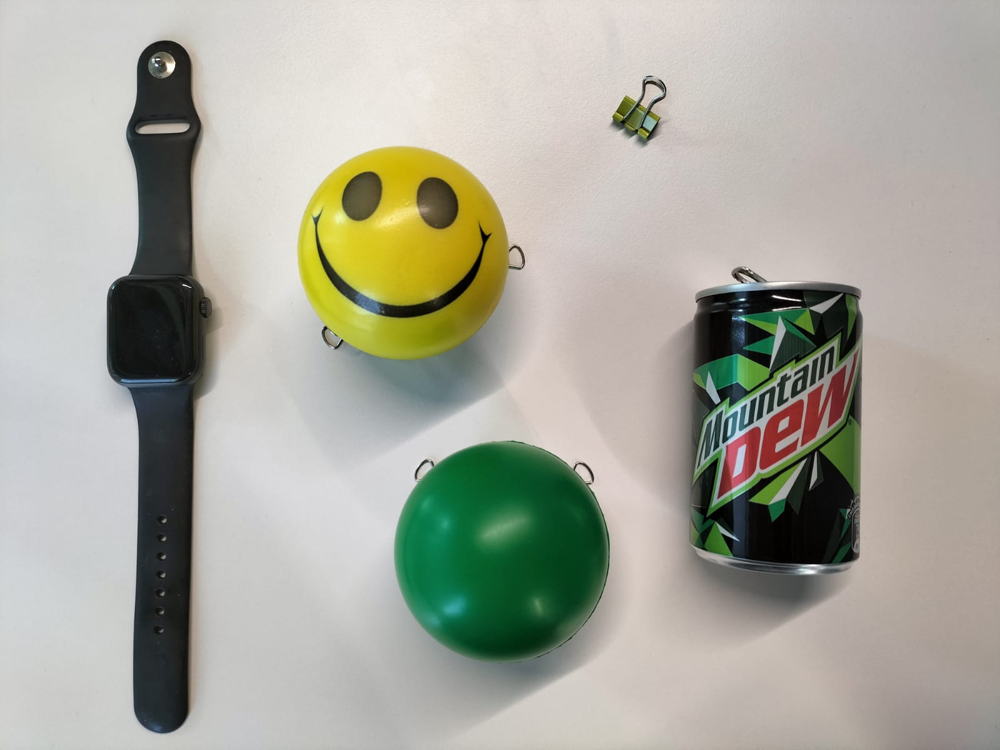

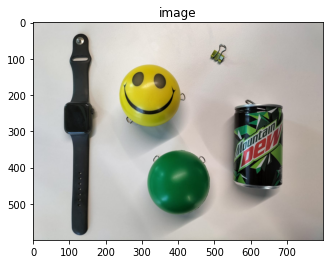

In [131]:
#@title opencv basics
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# read in the image
images_PATH = "/content/computer_vision_ai_club/slides_images/"
image_name = "demo.jpg"
image = cv2.imread(images_PATH + image_name)

# check if the image was successfully read
if image is None:
    print("Failed to read the image")
else:
    # # show the image on the screen used to open an new window
    # cv2.imshow("Image", image)
    # cv2.waitKey(0)
    # show the image on google colab
    cv2_imshow(image)
    scale_percent = 50 # percent of original size
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)
      
    # resize image
    image = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)

    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(rgb_image)
    # plt.imshow(image)
    plt.title("image")
    plt.show()




In [132]:
print("image object type: ",type(image))

print("the dimentions of image numpy array is: ",image.shape)

print("pixel value of index row:100, col: 100 : ",image[100,100,:])

image object type:  <class 'numpy.ndarray'>
the dimentions of image numpy array is:  (600, 800, 3)
pixel value of index row:100, col: 100 :  [208 209 206]


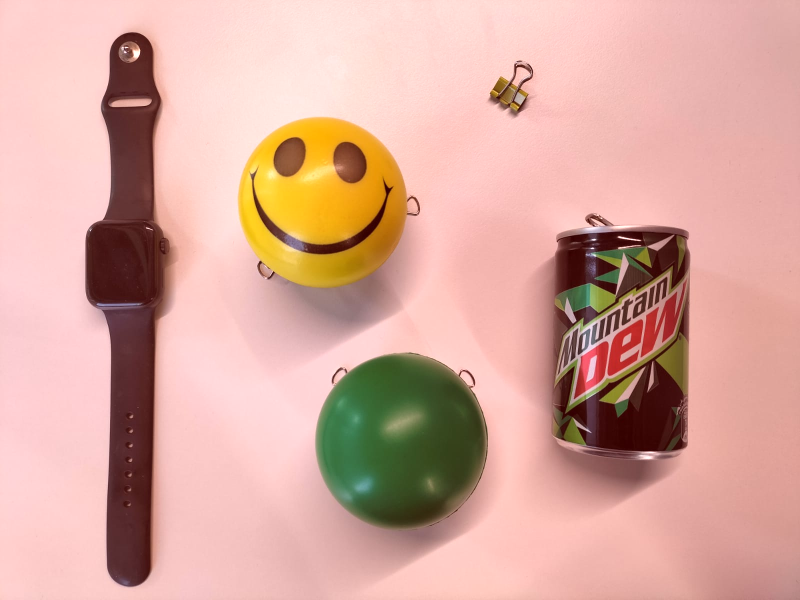

In [133]:
import copy
test_image = copy.deepcopy(image)
for i in range(image.shape[0]):
    for j in range(image.shape[1]):
        # get the red channel value of the pixel
        red = test_image[i, j, 2]
        # add 50 to the red channel value
        red += 50
        # make sure the value is not larger than 255
        red = min(red, 255)
        # set the new red channel value
        test_image[i, j, 2] = red
cv2_imshow(test_image)

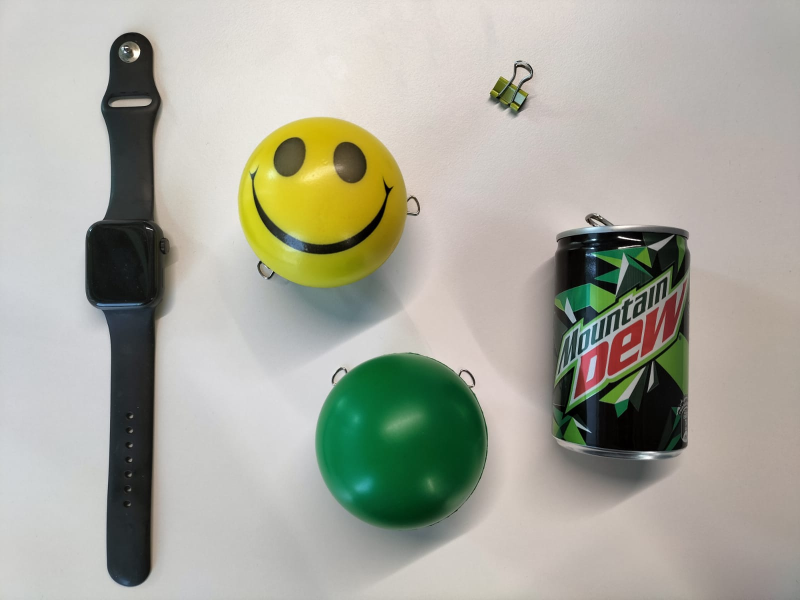

255


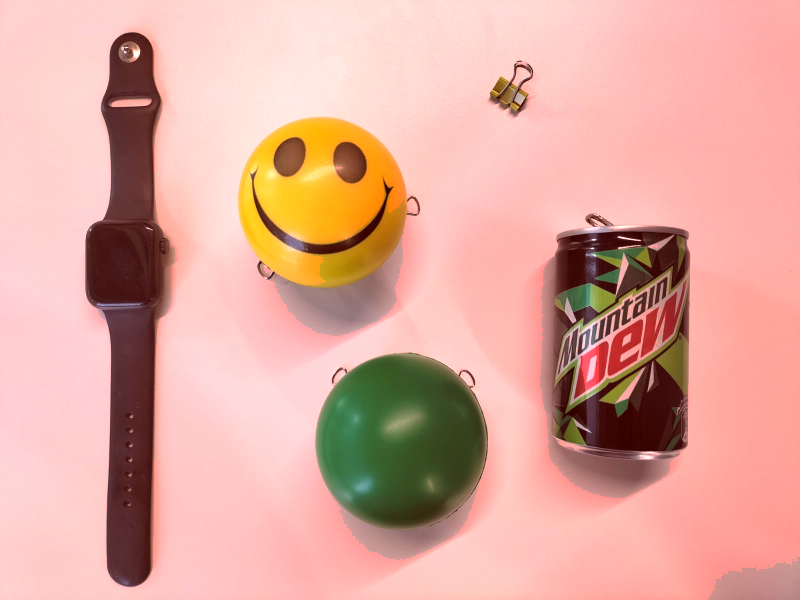

In [134]:
import numpy as np
test_image = copy.deepcopy(image)
cv2_imshow(test_image)
red_channel = test_image[:, :, 2]
added_value = 50
# add 50 to the red channel values
red_channel[red_channel<=(255-added_value)] += 50
red_channel[red_channel>(255-added_value)] = 255

# set the maximum red channel value to 255
red_channel = np.minimum(red_channel, 255)
print(red_channel[10,10])
# update the red channel of the image with the modified values
test_image[:, :, 2] = red_channel
cv2_imshow(test_image)

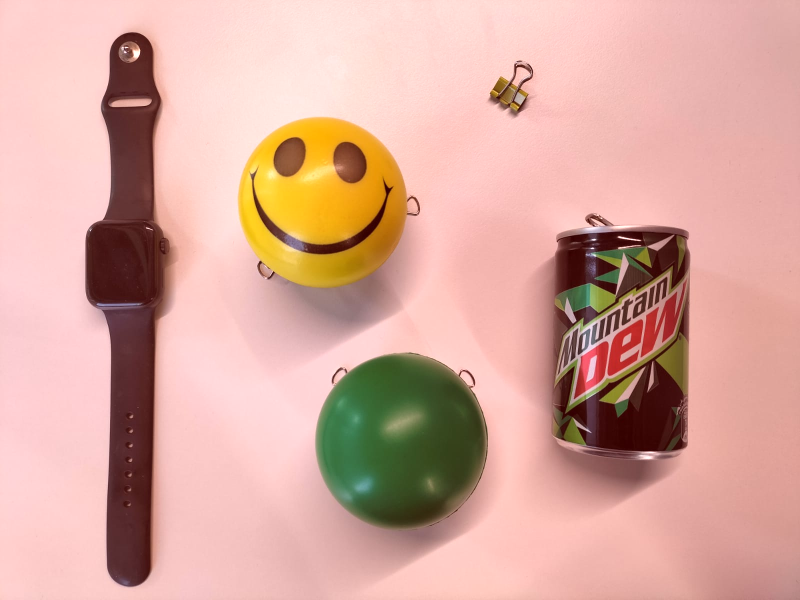

In [135]:
test_image = copy.deepcopy(image)
red_channel = test_image[:, :, 2]
red_channel = cv2.add(red_channel,50)
test_image[:, :, 2] = red_channel
cv2_imshow(test_image)

# Kernals, Filters, masks

Image processing kernel operation is a technique used to apply a filter or transformation to an image. The filter or transformation is specified by a small matrix of values called a kernel, which is applied to the pixels in the image to produce a new, modified image. This operation is commonly used to smooth or sharpen images, or to detect edges or other features in the image.

![kernal](https://github.com/mike1simon/computer_vision_ai_club/blob/main/slides_images/kernal.gif?raw=true)

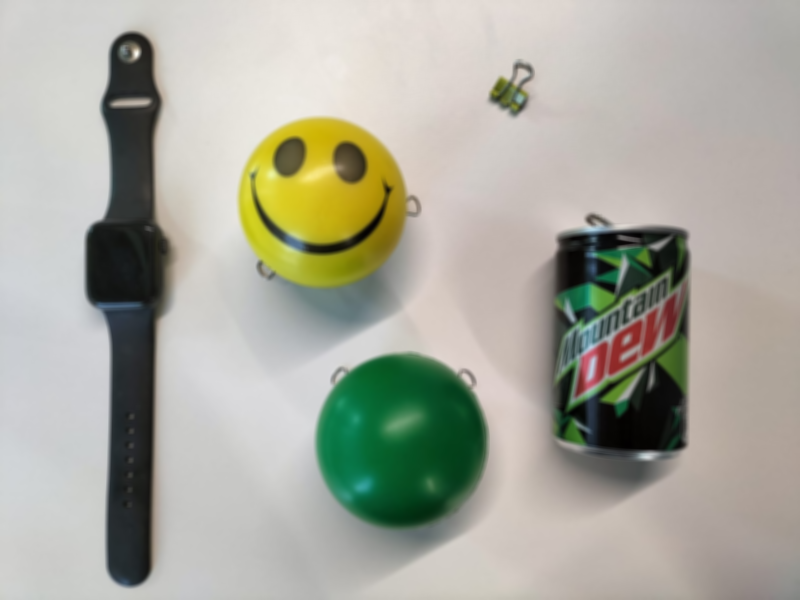

In [136]:
# Apply the mean average filter
mean_img = cv2.blur(image, (5,5))
cv2_imshow(mean_img)

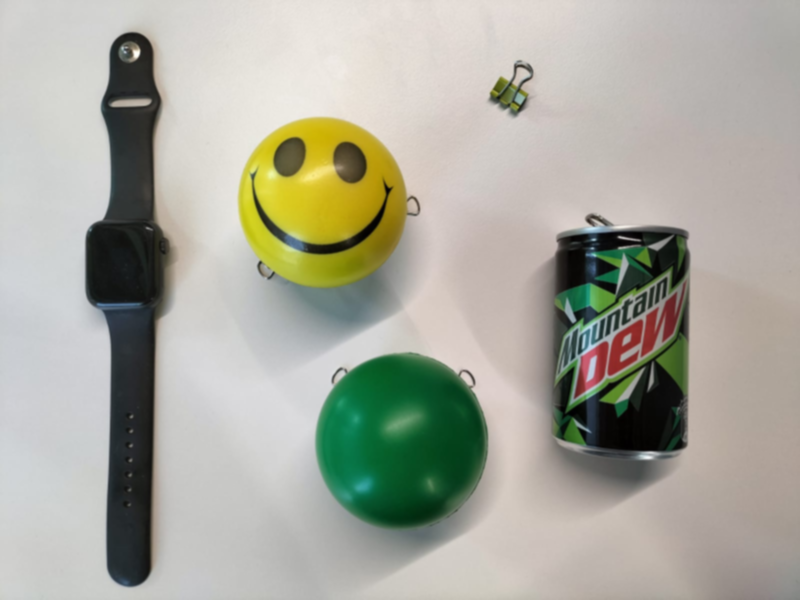

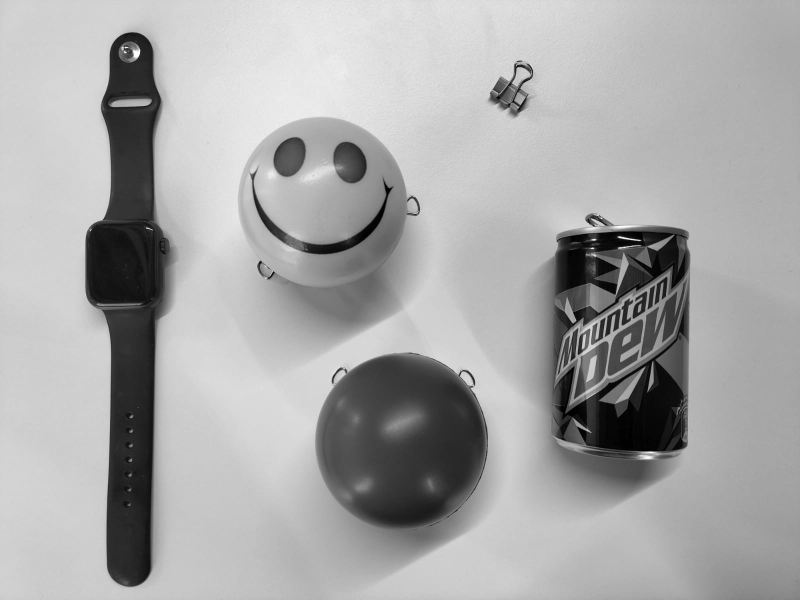

In [153]:
bgr_img_gaussian = cv2.GaussianBlur(image,(3,3),0)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
img_gaussian = cv2.GaussianBlur(gray,(3,3),0)
# img_gaussian = cv2.GaussianBlur(gray,(3,3),0)
cv2_imshow(bgr_img_gaussian)
cv2_imshow(gray)

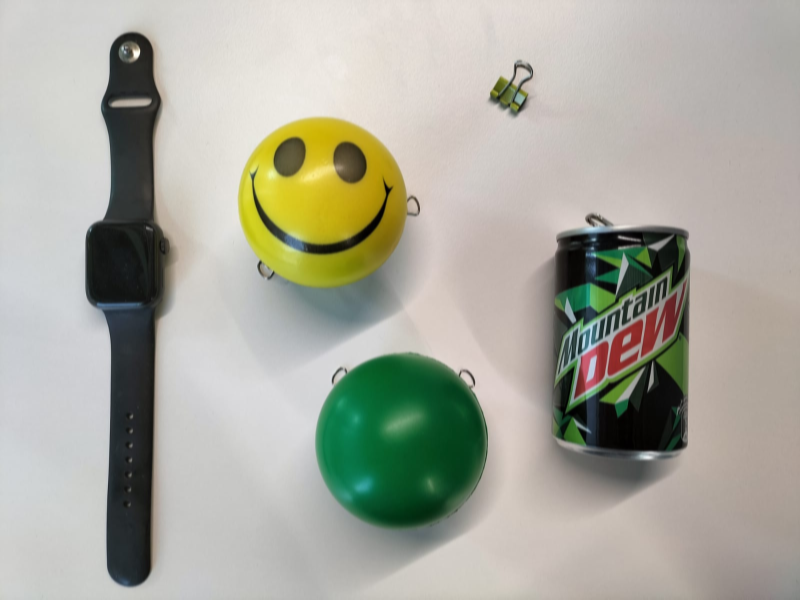

In [138]:
# Create a Gaussian kernel with size 3
gaussian_kernel = cv2.getGaussianKernel(5,-1)
# Apply the Gaussian kernel to the image
# Ddepth – Depth of the output image [ -1 will give the output image depth as same as the input image]
filtered_img = cv2.filter2D(image, ddepth=-1, kernel= gaussian_kernel)
cv2_imshow(filtered_img)

kernelx
[[ 1  1  1]
 [ 0  0  0]
 [-1 -1 -1]]
kernely
[[-1  0  1]
 [-1  0  1]
 [-1  0  1]]


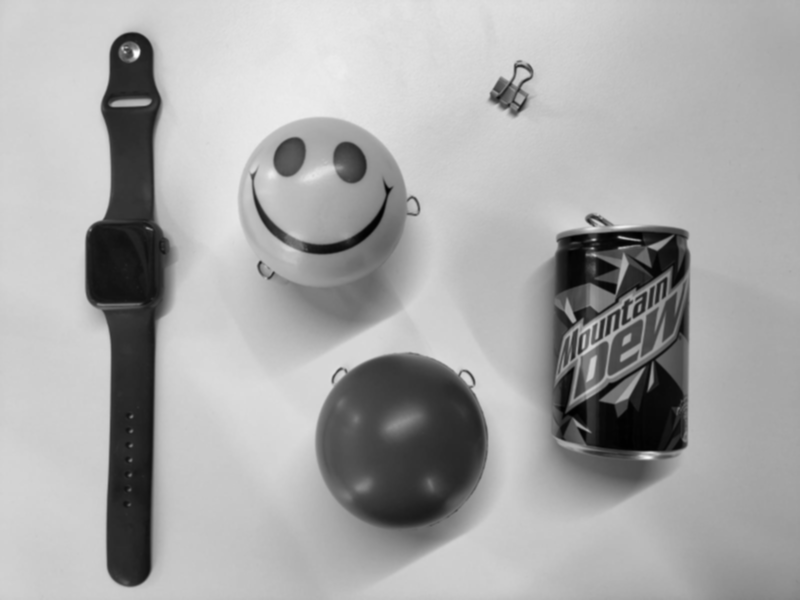

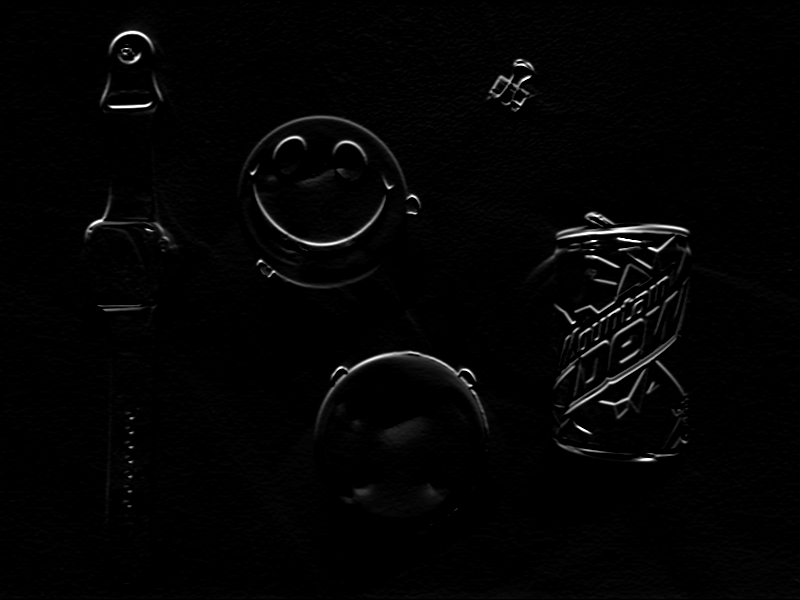

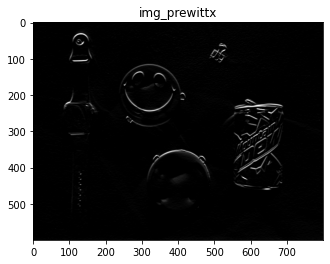

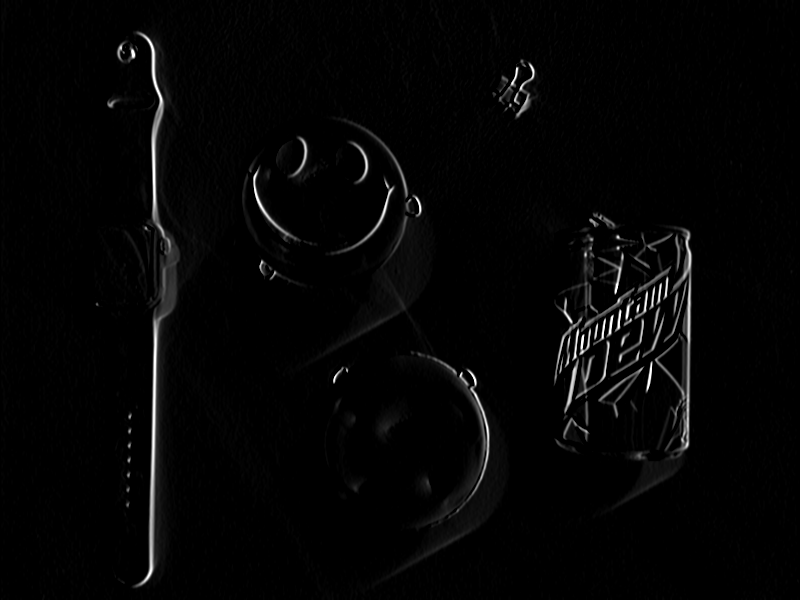

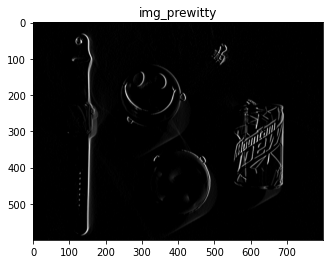

In [139]:
#@title Edge Detection
#prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
kernely = np.array([[-1,0,1],[-1,0,1],[-1,0,1]])
print("kernelx")
print(kernelx)
print("kernely")
print(kernely)
img_prewittx = cv2.filter2D(img_gaussian, -1, kernelx)
img_prewitty = cv2.filter2D(img_gaussian, -1, kernely)
cv2_imshow(img_gaussian)
cv2_imshow(img_prewittx)
plt.imshow(img_prewittx, cmap='gray')
plt.title("img_prewittx")
plt.show()
cv2_imshow(img_prewitty)
plt.imshow(img_prewitty, cmap='gray')
plt.title("img_prewitty")
plt.show()

kernelx
[[ 1  1  1]
 [ 0  0  0]
 [-1 -1 -1]]
kernely
[[-1  0  1]
 [-1  0  1]
 [-1  0  1]]
img_sobelx


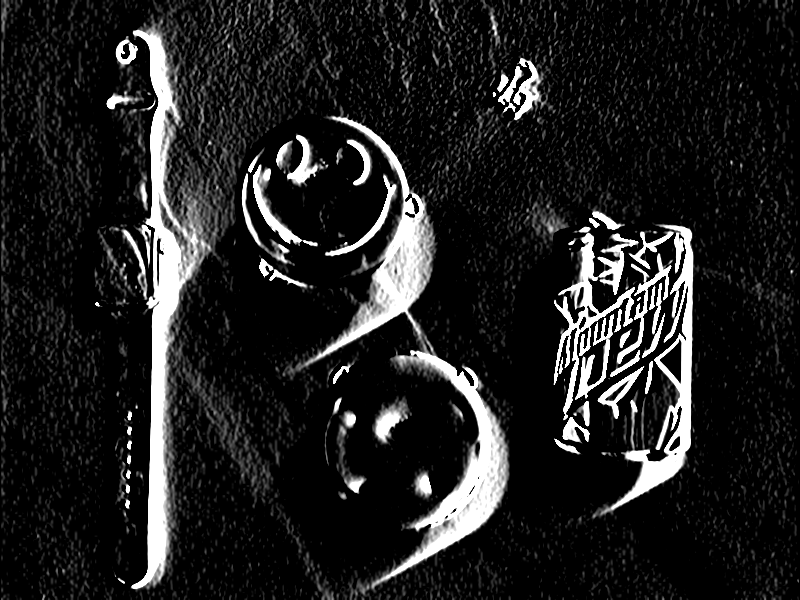

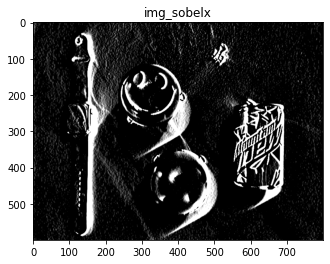

img_sobely


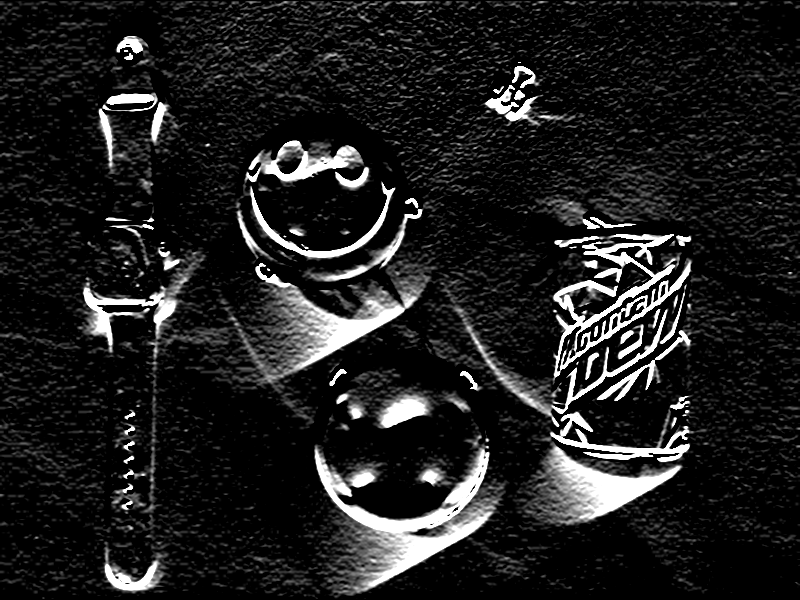

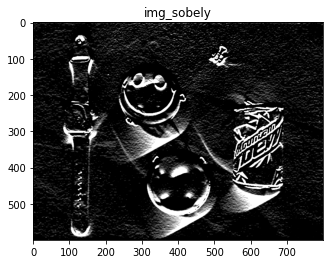

img_sobel


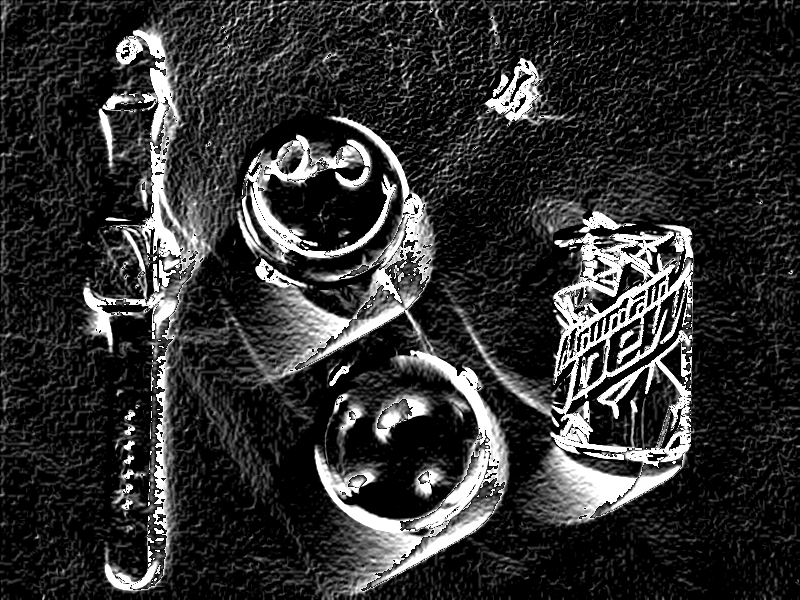

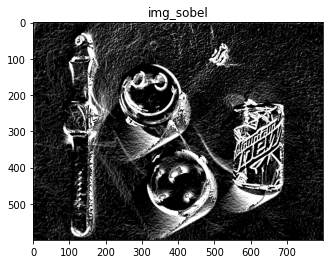

uint8
gradient_magnitude


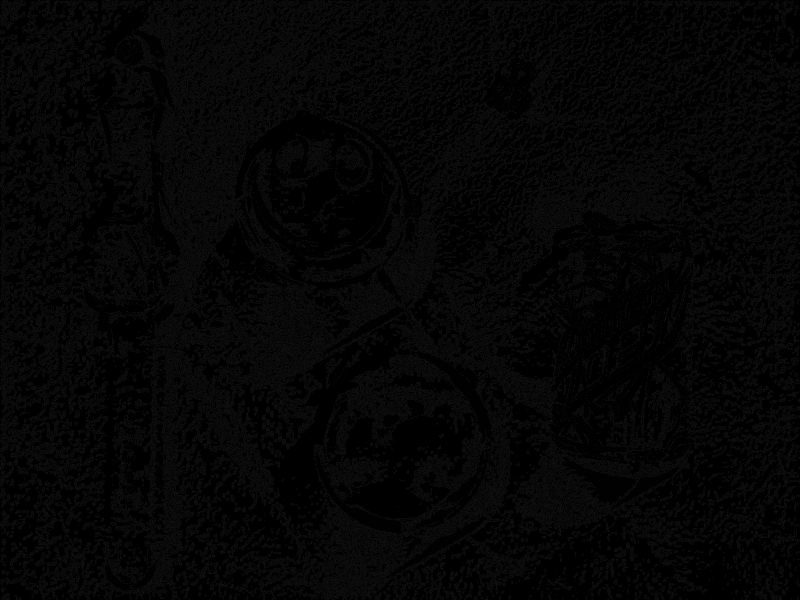

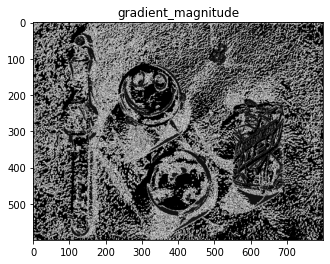

In [140]:
#sobel
img_sobelx = cv2.Sobel(img_gaussian,cv2.CV_8U,1,0,ksize=5)

img_sobely = cv2.Sobel(img_gaussian,cv2.CV_8U,0,1,ksize=5)

img_sobel = img_sobelx + img_sobely

gradient_magnitude = np.sqrt(np.square(img_sobelx) + np.square(img_sobely))
 
# gradient_magnitude *= 255.0 / gradient_magnitude.max()

print("kernelx")
print(kernelx)
print("kernely")
print(kernely)
print("img_sobelx")
cv2_imshow(img_sobelx)
plt.imshow(img_sobelx, cmap='gray')
plt.title("img_sobelx")
plt.show()
print("img_sobely")
cv2_imshow(img_sobely)
plt.imshow(img_sobely, cmap='gray')
plt.title("img_sobely")
plt.show()
print("img_sobel")
cv2_imshow(img_sobel)
plt.imshow(img_sobel, cmap='gray')
plt.title("img_sobel")
plt.show()
print(img_sobel.dtype)

print("gradient_magnitude")
cv2_imshow(gradient_magnitude)
plt.imshow(gradient_magnitude.astype(np.float32), cmap='gray')
plt.title("gradient_magnitude")
plt.show()


img_sobelx


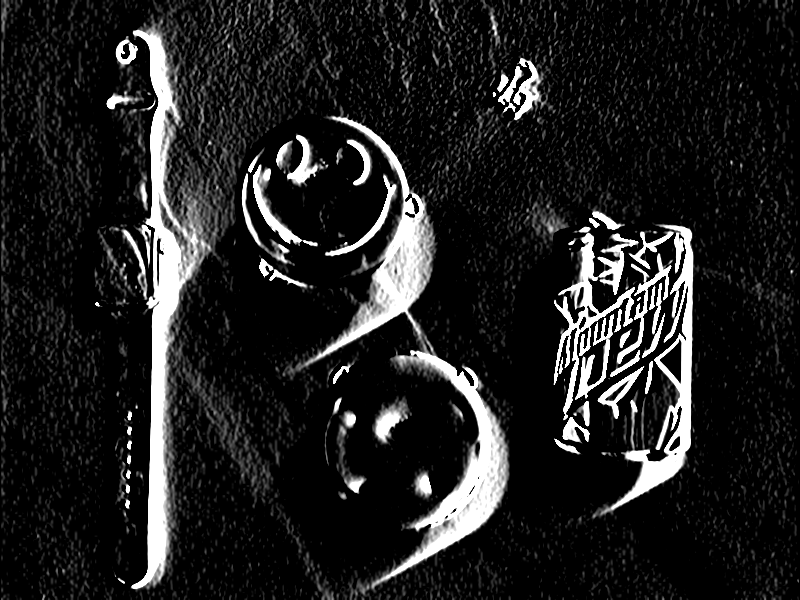

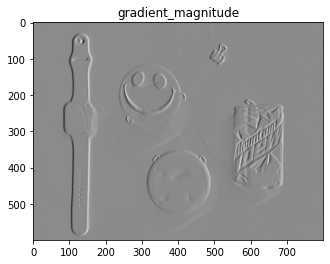

img_sobely


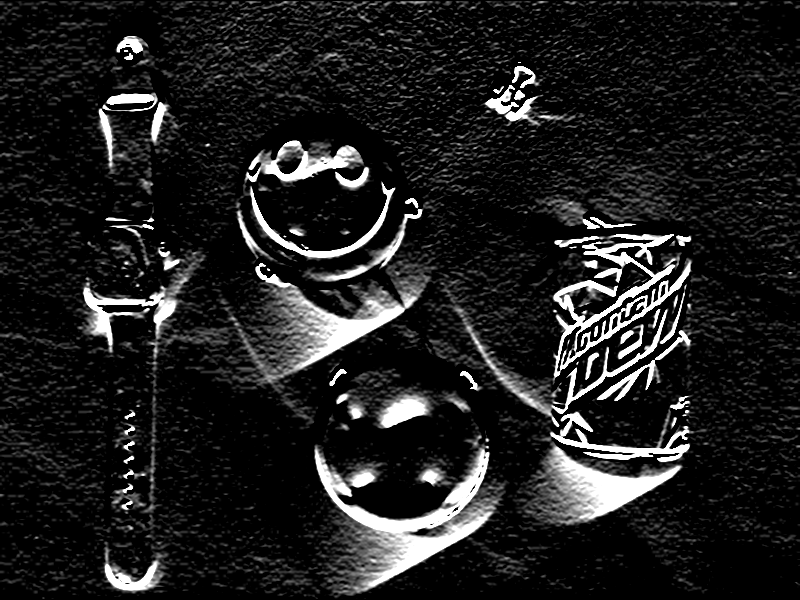

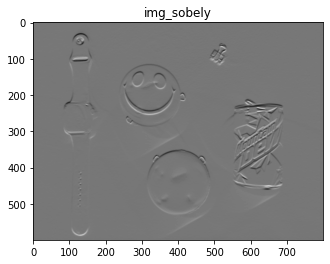

img_sobel


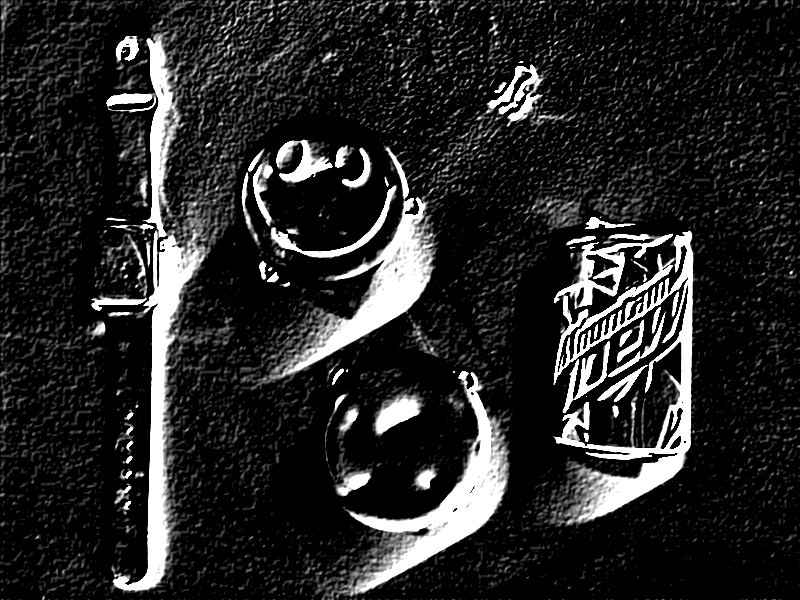

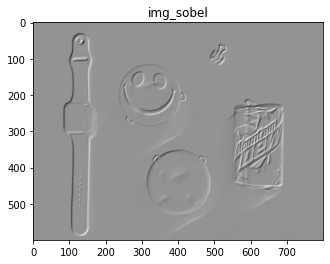

int16


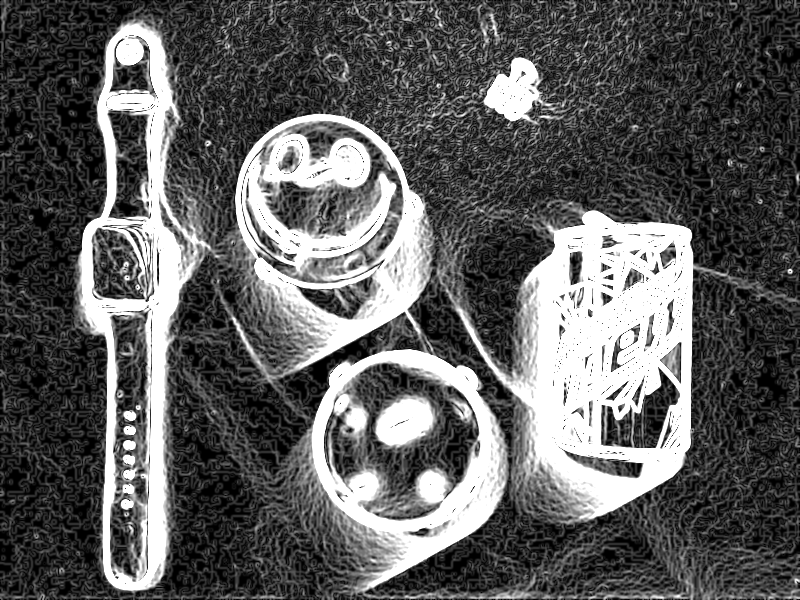

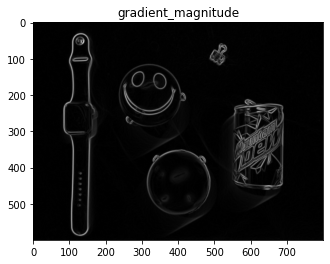

In [141]:
#sobel
img_sobelx = cv2.Sobel(img_gaussian,cv2.CV_16S,1,0,ksize=5)

img_sobely = cv2.Sobel(img_gaussian,cv2.CV_16S,0,1,ksize=5)

img_sobel = img_sobelx + img_sobely

print("img_sobelx")
cv2_imshow(img_sobelx)
plt.imshow(img_sobelx.astype(np.float32), cmap='gray')
plt.title("gradient_magnitude")
plt.show()
print("img_sobely")
cv2_imshow(img_sobely)
plt.imshow(img_sobely.astype(np.float32), cmap='gray')
plt.title("img_sobely")
plt.show()
print("img_sobel")
cv2_imshow(img_sobel)
plt.imshow(img_sobel.astype(np.float32), cmap='gray')
plt.title("img_sobel")
plt.show()
print(img_sobel.dtype)

gradient_magnitude = np.sqrt(np.square(img_sobelx.astype(np.float32)) + np.square(img_sobely.astype(np.float32)))
cv2_imshow(gradient_magnitude)
plt.imshow(gradient_magnitude, cmap='gray')
plt.title("gradient_magnitude")
plt.show()


In [142]:
print("img_sobely minimum value: ",np.min(np.min(img_sobely)))
print("img_sobely maximum value: ",np.max(np.max(img_sobely)))

img_sobely minimum value:  -7086
img_sobely maximum value:  8086


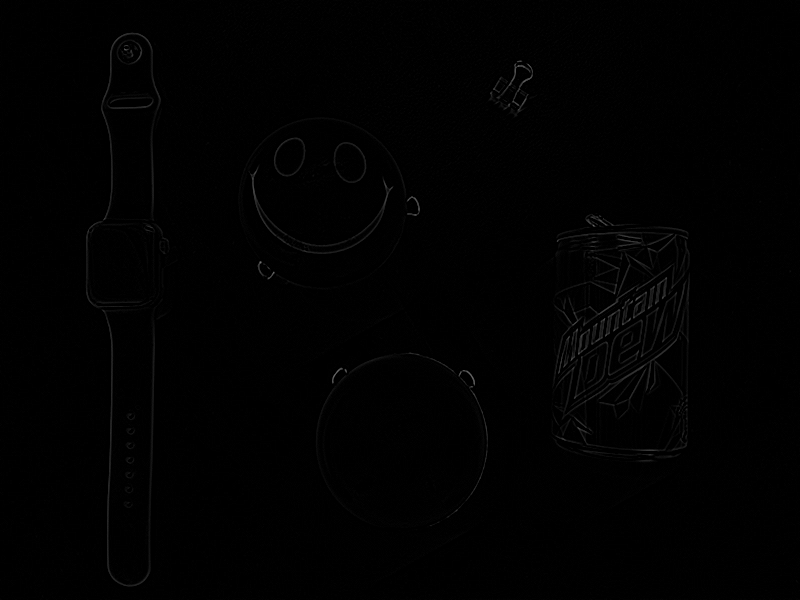

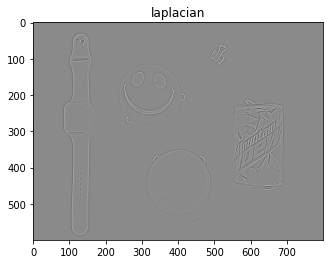

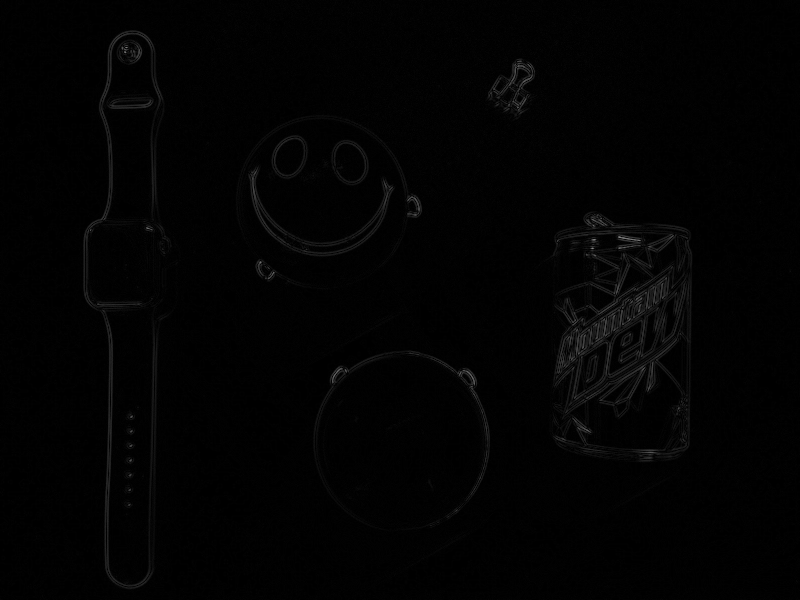

In [143]:
laplacian = cv2.Laplacian(img_gaussian,cv2.CV_64F)
laplacian_abs = cv2.convertScaleAbs(laplacian)
cv2_imshow(laplacian)
plt.imshow(laplacian, cmap='gray')
plt.title("laplacian")
plt.show()
cv2_imshow(laplacian_abs)

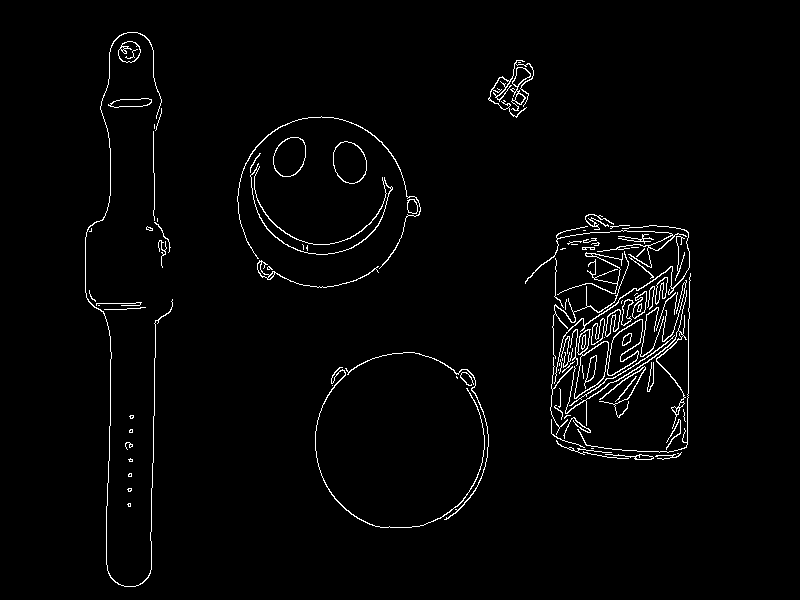

In [151]:
# Apply the Canny edge detection filter
edges = cv2.Canny(img_gaussian, 20, 150)
cv2_imshow(edges)

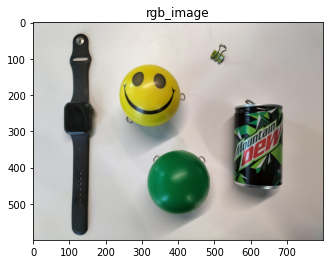

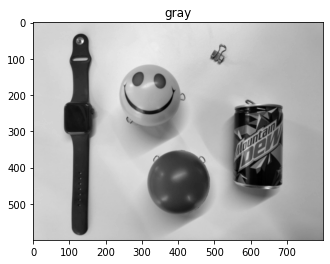

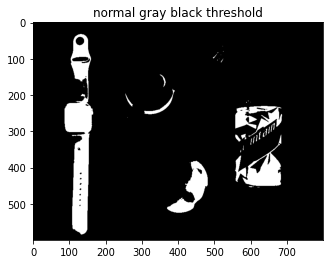

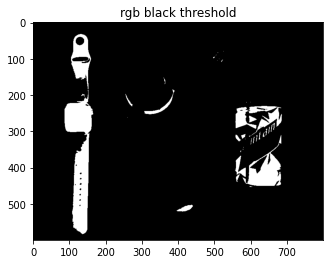

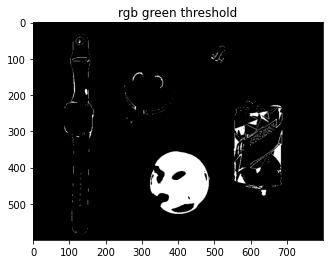

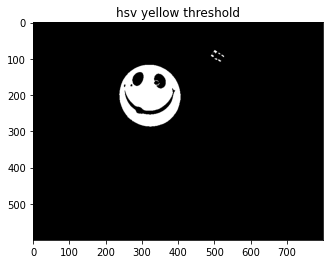

(<matplotlib.image.AxesImage at 0x7f9df288cc40>,
 Text(0.5, 1.0, 'hsv yellow threshold'),
 None)

In [211]:
#@title Threshold and Morphological operations
gray = cv2.cvtColor(bgr_img_gaussian, cv2.COLOR_BGR2GRAY)
# Convert the image to HSV color space
hsv = cv2.cvtColor(bgr_img_gaussian, cv2.COLOR_BGR2HSV)

# Threshold the image to find the black area
_, threshold = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV)

# Threshold the image to only select dark colors from r,g,b
lower_b = np.array([0, 0, 0])
upper_b = np.array([50, 50, 50])
black_mask = cv2.inRange(bgr_img_gaussian, lower_b, upper_b)

# Threshold the image to only select green color
lower_b = np.array([0, 60, 0])
upper_b = np.array([75, 255, 75])
green_mask = cv2.inRange(bgr_img_gaussian, lower_b, upper_b)

# Define the range of yellow colors in HSV space
lower_yellow = np.array([20, 100, 100])
upper_yellow = np.array([35, 255, 255])
# Threshold the image to only select yellow colors
yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

# Show the original and thresholded images
# cv2_imshow(bgr_img_gaussian)
# cv2_imshow(gray)
# cv2_imshow(threshold)
# cv2_imshow(black_mask)
# cv2_imshow(green_mask)
# cv2_imshow(yellow_mask)
plt.imshow(rgb_image), plt.title("rgb_image"), plt.show()
plt.imshow(gray, cmap='gray'), plt.title("gray"), plt.show()
plt.imshow(threshold, cmap='gray'), plt.title("normal gray black threshold"), plt.show()
plt.imshow(black_mask, cmap='gray'), plt.title("rgb black threshold"), plt.show()
plt.imshow(green_mask, cmap='gray'), plt.title("rgb green threshold"), plt.show()
plt.imshow(yellow_mask, cmap='gray'), plt.title("hsv yellow threshold"), plt.show()


# morphological operations
## Erosion
Erosion primarily involves eroding the outer surface (the foreground) of the image. As binary images only contain two pixels 0 and 255, it primarily involves eroding the foreground of the image and it is suggested to have the foreground as white. The thickness of erosion depends on the size and shape of the defined kernel. We can make use of NumPy’s ones() function to define a kernel. There are a lot of other functions like NumPy zeros, customized kernels, and others that can be used to define kernels based on the problem in hand.

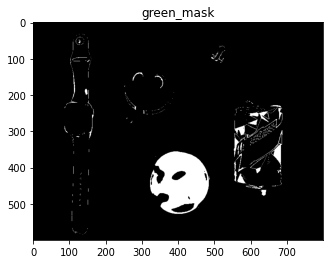

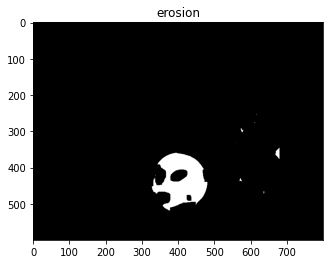

(<matplotlib.image.AxesImage at 0x7f9df2663c10>,
 Text(0.5, 1.0, 'erosion'),
 None)

In [216]:
#@title morphological operations


# define the kernel
kernel = np.ones((5, 5), np.uint8)
# invert the image
invert_green_mask = cv2.bitwise_not(green_mask)

# erode the image
erosion = cv2.erode(green_mask, kernel,
                    iterations=2)

plt.imshow(green_mask, cmap='gray'), plt.title("green_mask"), plt.show()
plt.imshow(erosion, cmap='gray'), plt.title("erosion"), plt.show()


## Dilation
Dilation involves dilating the outer surface (the foreground) of the image. As binary images only contain two pixels 0 and 255, it primarily involves expanding the foreground of the image and it is suggested to have the foreground as white. The thickness of erosion depends on the size and shape of the defined kernel. We can make use of NumPy’s ones() function to define a kernel. There are a lot of other functions like NumPy zeros, customized kernels, and others that can be used to define kernels based on the problem at hand. It is exactly opposite to the erosion operation



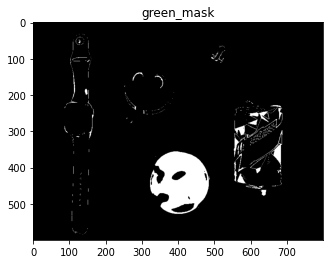

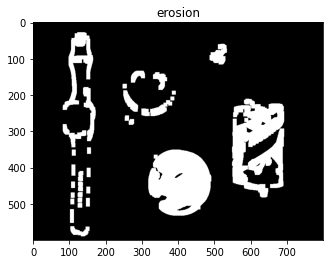

(<matplotlib.image.AxesImage at 0x7f9df250c790>,
 Text(0.5, 1.0, 'erosion'),
 None)

In [219]:
# define the kernel
kernel = np.ones((3, 3), np.uint8) 
# dilate the image
dilation = cv2.dilate(green_mask, kernel, iterations=5)
plt.imshow(green_mask, cmap='gray'), plt.title("green_mask"), plt.show()
plt.imshow(dilation, cmap='gray'), plt.title("erosion"), plt.show()


## Opening
Opening involves erosion followed by dilation in the outer surface (the foreground) of the image. All the above-said constraints for erosion and dilation applies here. It is a blend of the two prime methods. It is generally used to remove the noise in the image.



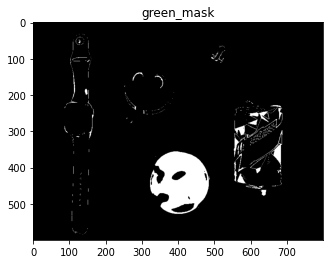

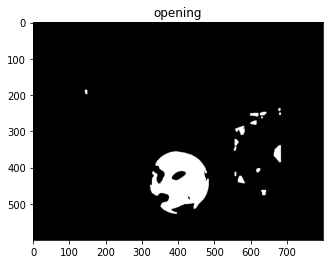

(<matplotlib.image.AxesImage at 0x7f9df2127760>,
 Text(0.5, 1.0, 'opening'),
 None)

In [235]:
# define the kernel
kernel = np.ones((5, 5), np.uint8)
 
# opening the image
opening = cv2.morphologyEx(green_mask, cv2.MORPH_OPEN,kernel, iterations=1)
plt.imshow(green_mask, cmap='gray'), plt.title("green_mask"), plt.show()
plt.imshow(opening, cmap='gray'), plt.title("opening"), plt.show()


## Closing
Closing involves dilation followed by erosion in the outer surface (the foreground) of the image. All the above-said constraints for erosion and dilation applies here. It is a blend of the two prime methods. It is generally used to remove the noise in the image.



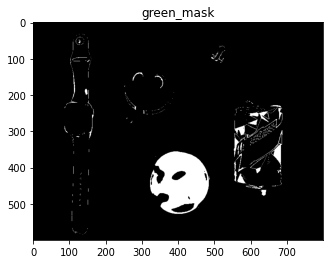

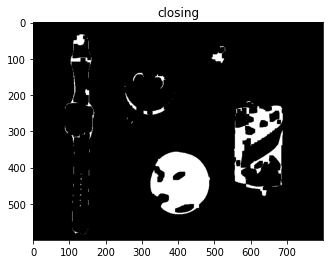

(<matplotlib.image.AxesImage at 0x7f9df1f35a00>,
 Text(0.5, 1.0, 'closing'),
 None)

In [238]:
# define the kernel
kernel = np.ones((10, 10), np.uint8)
 
# opening the image
closing = cv2.morphologyEx(green_mask, cv2.MORPH_CLOSE, kernel, iterations=1)
plt.imshow(green_mask, cmap='gray'), plt.title("green_mask"), plt.show()
plt.imshow(closing, cmap='gray'), plt.title("closing"), plt.show()


## Morphological Gradient
Morphological gradient is slightly different than the other operations, because, the morphological gradient first applies erosion and dilation individually on the image and then computes the difference between the eroded and dilated image. The output will be an outline of the given image.



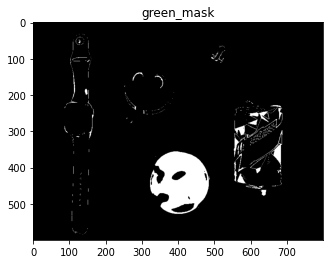

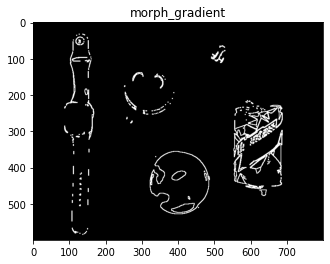

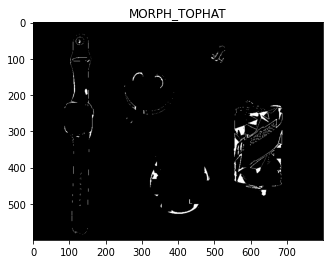

(<matplotlib.image.AxesImage at 0x7f9df1dd2d60>,
 Text(0.5, 1.0, 'MORPH_TOPHAT'),
 None)

In [245]:
# define the kernel
kernel = np.ones((3, 3), np.uint8)
  
# use morph gradient
morph_gradient = cv2.morphologyEx(green_mask, cv2.MORPH_GRADIENT,kernel)
plt.imshow(green_mask, cmap='gray'), plt.title("green_mask"), plt.show()
plt.imshow(morph_gradient, cmap='gray'), plt.title("morph_gradient"), plt.show()


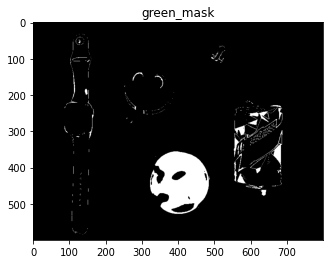

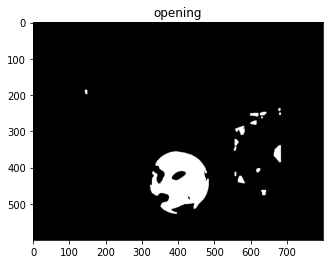

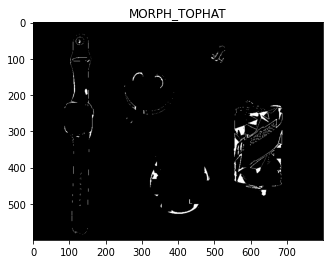

(<matplotlib.image.AxesImage at 0x7f9df1b0ca60>,
 Text(0.5, 1.0, 'MORPH_TOPHAT'),
 None)

In [248]:
# Top Hat
kernel = np.ones((13, 13), np.uint8)
morph_gradient = cv2.morphologyEx(green_mask,cv2.MORPH_TOPHAT,kernel)
plt.imshow(green_mask, cmap='gray'), plt.title("green_mask"), plt.show()
plt.imshow(opening, cmap='gray'), plt.title("opening"), plt.show()
plt.imshow(morph_gradient, cmap='gray'), plt.title("MORPH_TOPHAT"), plt.show()


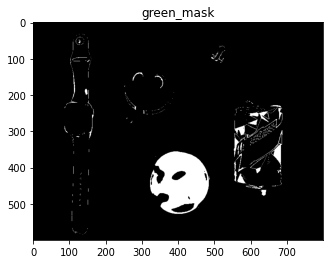

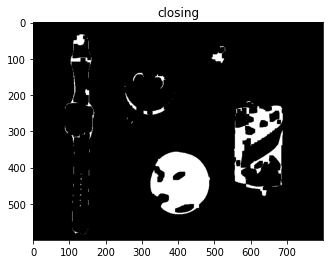

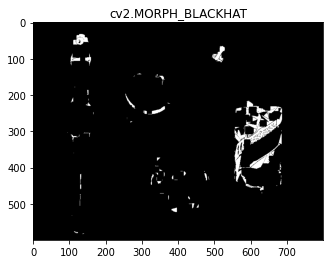

(<matplotlib.image.AxesImage at 0x7f9df1920d00>,
 Text(0.5, 1.0, 'cv2.MORPH_BLACKHAT'),
 None)

In [250]:
# Black Hat
kernel = np.ones((13, 13), np.uint8)
morph_gradient = cv2.morphologyEx(green_mask,cv2.MORPH_BLACKHAT,kernel)
plt.imshow(green_mask, cmap='gray'), plt.title("green_mask"), plt.show()
plt.imshow(closing, cmap='gray'), plt.title("closing"), plt.show()
plt.imshow(morph_gradient, cmap='gray'), plt.title("cv2.MORPH_BLACKHAT"), plt.show()



# Hough Lines

As you know, a line in the image space can be expressed with two variables. For example:

In the Cartesian coordinate system: Parameters: (m,b).
In the Polar coordinate system: Parameters: (r,θ)
Hough_Lines_Tutorial_Theory_0.jpg
![Hough_Lines_Tutorial](https://github.com/mike1simon/computer_vision_ai_club/blob/main/slides_images/Hough_Line_diag.jpg?raw=true)

For Hough Transforms, we will express lines in the Polar system. Hence, a line equation can be written as:

![y=(−cosθsinθ)x+(rsinθ)](https://github.com/mike1simon/computer_vision_ai_club/blob/main/slides_images/hough_line_eq1.png?raw=true)

Arranging the terms:   

            r = x * cosθ + y * sinθ


1. In general for each point (x0,y0), we can define the family of lines that goes through that point as:

        r(θ)=x0 ⋅ cosθ + y0 ⋅ sinθ
Meaning that each pair (rθ,θ) represents each line that passes by (x0,y0).

2. If for a given (x0,y0) we plot the family of lines that goes through it, we get a sinusoid. For instance, for x0=8 and y0=6 we get the following plot (in a plane θ - r):

  ![one point in a plane θ - r](https://github.com/mike1simon/computer_vision_ai_club/blob/main/slides_images/Hough_Lines_diag2.jpg?raw=true)

3. We can do the same operation above for all the points in an image. If the curves of two different points intersect in the plane θ - r, that means that both points belong to a same line. For instance, following with the example above and drawing the plot for two more points: x1=4, y1=9 and x2=12, y2=3, we get: 

  ![multiple points in a plane θ - r](https://github.com/mike1simon/computer_vision_ai_club/blob/main/slides_images/Hough_Lines_diag3.jpg?raw=true).

  We consider only points such that r > 0 and 0 < θ < 2π

  The three plots intersect in one single point (0.925,9.6), these coordinates are the parameters ( θ,r) or the line in which (x0,y0), (x1,y1) and (x2,y2) lay.

4. What does all the stuff above mean? It means that in general, a line can be detected by finding the number of intersections between curves.The more curves intersecting means that the line represented by that intersection have more points. In general, we can define a threshold of the minimum number of intersections needed to detect a line.
5. This is what the Hough Line Transform does. It keeps track of the intersection between curves of every point in the image. If the number of intersections is above some threshold, then it declares it as a line with the parameters (θ,rθ) of the intersection point.


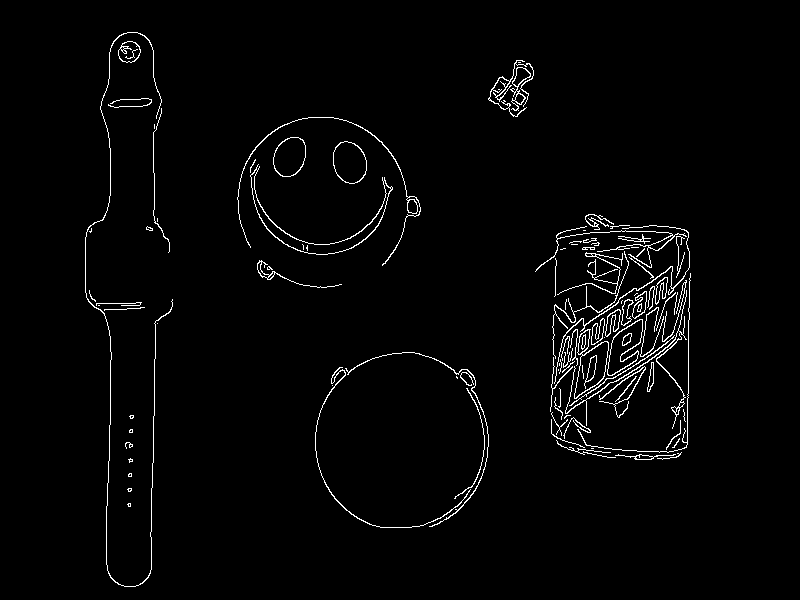

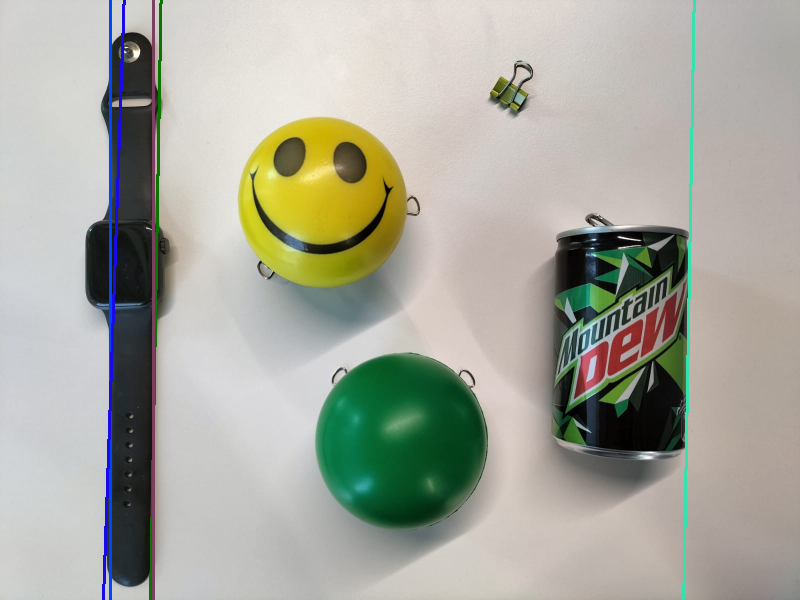

In [276]:
# Convert the img to grayscale
gray = cv2.cvtColor(bgr_img_gaussian, cv2.COLOR_BGR2GRAY)
 
# Apply edge detection method on the image
edges = cv2.Canny(gray, 50, 150, apertureSize=3)
cv2_imshow(edges)

# This returns an array of r and theta values
lines = cv2.HoughLines(edges, 1, np.pi/180, 120)

test_image = copy.deepcopy(image)
# The below for loop runs till r and theta values are in the range of 2d array
if lines is None:
  print("No lines were found")
else:
  for r_theta in lines:
      arr = np.array(r_theta[0], dtype=np.float64)
      r, theta = arr
      # Stores the value of cos(theta) in a
      a = np.cos(theta)
      # Stores the value of sin(theta) in b
      b = np.sin(theta)
      # x0 stores the value rcos(theta)
      x0 = a*r
      # y0 stores the value rsin(theta)
      y0 = b*r
      # x1 stores the rounded off value of (rcos(theta)-1000sin(theta))
      x1 = int(x0 + 1000*(-b))
      # y1 stores the rounded off value of (rsin(theta)+1000cos(theta))
      y1 = int(y0 + 1000*(a))
      # x2 stores the rounded off value of (rcos(theta)+1000sin(theta))
      x2 = int(x0 - 1000*(-b))
      # y2 stores the rounded off value of (rsin(theta)-1000cos(theta))
      y2 = int(y0 - 1000*(a))
      # cv2.line draws a line in img from the point(x1,y1) to (x2,y2).
      # (0,0,255) denotes the colour of the line to be
      # drawn. In this case, it is red.
      color = (np.random.rand(3,1) *255).astype(int)
      cv2.line(test_image, (x1, y1), (x2, y2),
               [int(color[0][0]),int(color[1][0]),int(color[2][0])], 2)
  # All the changes made in the input image are finally
  cv2_imshow(test_image)


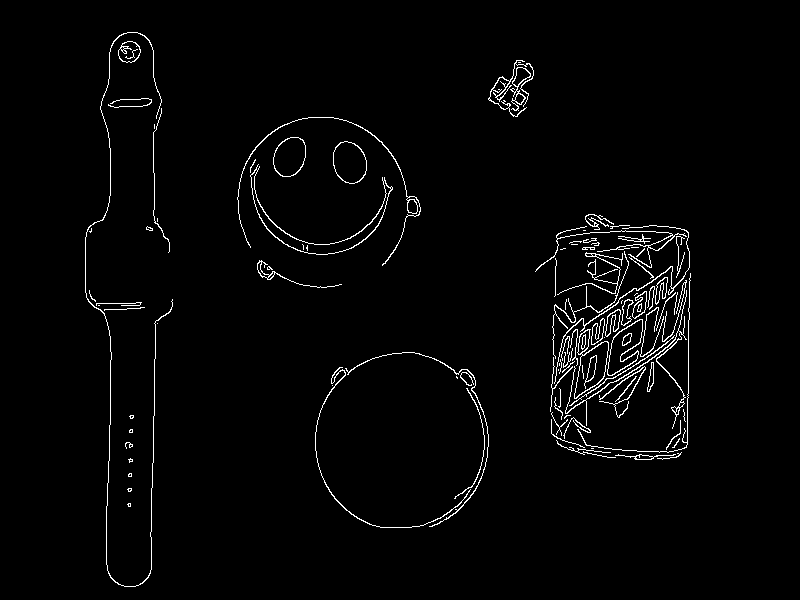

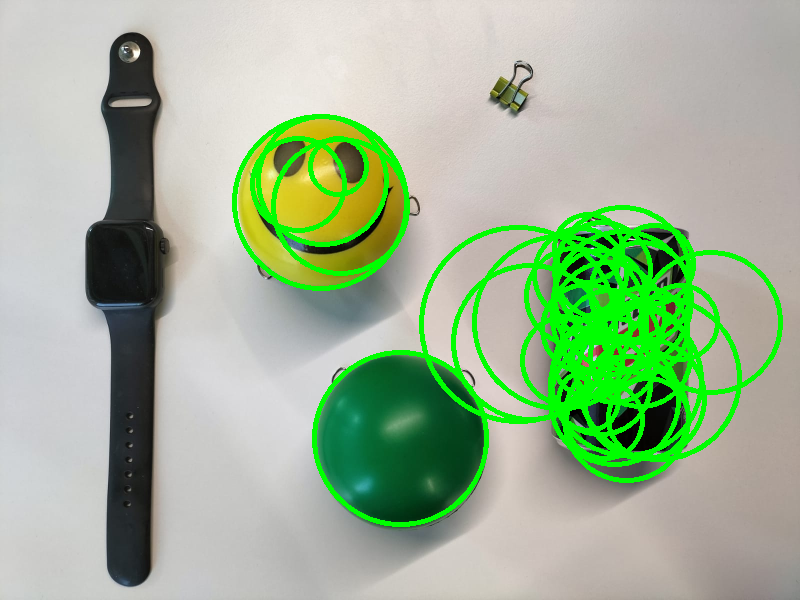

In [278]:
# Convert the img to grayscale
gray = cv2.cvtColor(bgr_img_gaussian, cv2.COLOR_BGR2GRAY)
 
# Apply edge detection method on the image
edges = cv2.Canny(gray, 50, 150, apertureSize=3)
cv2_imshow(edges)

# Use the Hough transform to detect circles in the image
circles = cv2.HoughCircles(edges, cv2.HOUGH_GRADIENT, 1, 20, param1=50, param2=30, minRadius=25, maxRadius=100)
test_image = copy.deepcopy(image)
# Draw the detected circles on the image
if circles is not None:
    circles = np.round(circles[0, :]).astype("int")
    maximum_r = 0
    for (x, y, r) in circles:
      cv2.circle(test_image, (x, y), r, (0, 255, 0), 4)

cv2_imshow(test_image)


In [170]:
# Python program that uses the OpenCV library and threshold an image by the yellow color then preform closing morph
# operation then provide the output image to a canny edge detector then calculate the contour of the objects
# of the resulting image and then provide these contours to a Hough circle detector with minimum radius
# of 50 and maximum radius of 150 then draw the center of the circle as well as the circle

# Convert the image to HSV color space

# Define the range of yellow colors in HSV space

# Threshold the image to only select yellow colors

# Apply a closing morphological operation to close gaps in the mask with a kernal of ?

# Apply the Canny edge detection filter

# Use the Hough transform to detect circles in the image

# Draw the detected circles on the image


# Camera Model and Camera Calibration
**bold text**
Camera calibration is the process of determining the intrinsic and extrinsic parameters of a camera. These parameters include the focal length, distortion coefficients, and camera orientation, among others. Camera calibration is necessary to correct for lens distortion and to enable accurate measurements from the images taken by the camera.

[camera calibration detailed description opencv](https://docs.opencv.org/3.4/d9/d0c/group__calib3d.html)

[Camera Calibration and 3D Reconstruction opencv tutorials](https://docs.opencv.org/4.x/d9/db7/tutorial_py_table_of_contents_calib3d.html)

[Pose Estimation](https://docs.opencv.org/4.x/d7/d53/tutorial_py_pose.html)

[Camera Calibration Python](https://docs.opencv.org/4.x/dc/dbb/tutorial_py_calibration.html)

In [27]:
CHECKERBOARD = (6, 9)
objectp3d = np.zeros((1, CHECKERBOARD[0]* CHECKERBOARD[1],3), np.float32)
objectp3d[0,:,:2]

array([[0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.]], dtype=float32)

In [93]:

# Import required modules
import cv2
import numpy as np
import os
import glob
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

 
# Define the dimensions of checkerboard
CHECKERBOARD = (6, 9)
 
 
# stop the iteration when specified
# accuracy, epsilon, is reached or
# specified number of iterations are completed.
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
# Vector for 3D points
threedpoints = []
# Vector for 2D points
twodpoints = []
 
 
#  3D points real world coordinates
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objectp3d = np.zeros((1, CHECKERBOARD[0]* CHECKERBOARD[1],3), np.float32)
objectp3d[0, :, :2] = np.mgrid[0:CHECKERBOARD[0],0:CHECKERBOARD[1]].T.reshape(-1, 2)
objectp3d = objectp3d*0.024

In [ ]:
print(objectp3d)

In [95]:
prev_img_shape = None
# Extracting path of individual image stored
# in a given directory. 
# jpg files alone
images_PATH = "/content/computer_vision_ai_club/calibration_images/"
images = glob.glob(images_PATH+'*.jpg')
print(images)

['/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_00_51_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_12_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_00_59_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_34_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_08_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_23_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_01_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_41_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_00_44_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_37_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_20221210_13_01_10_Pro.jpg', '/content/computer_vision_ai_club/calibration_images/WIN_2022121

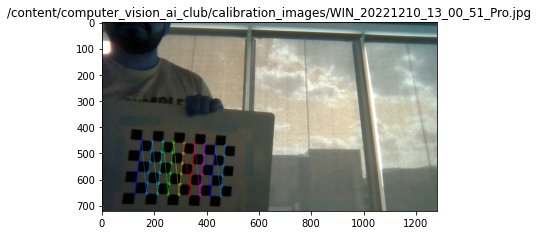

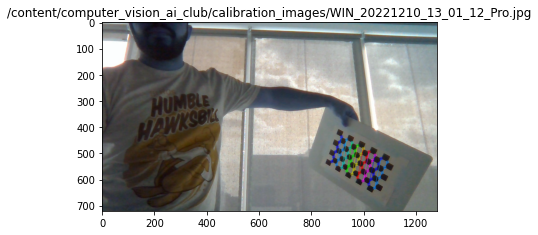

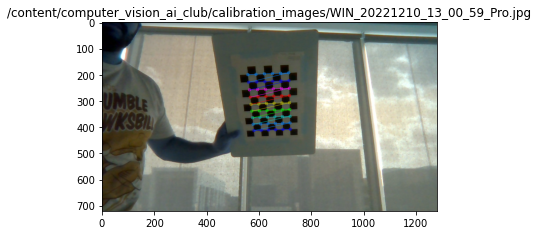

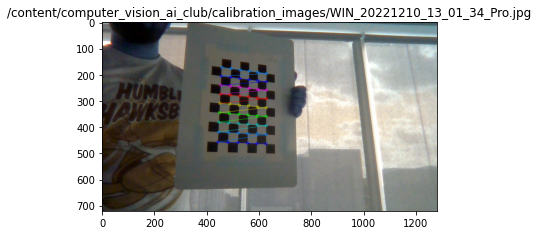

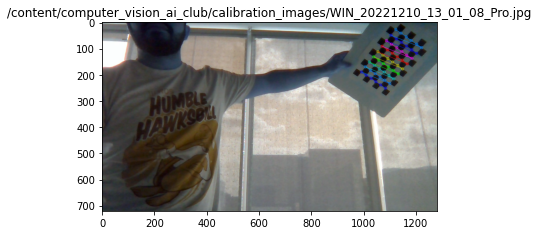

...

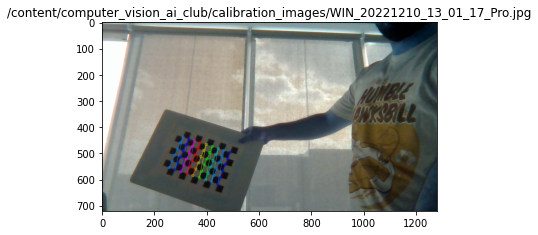

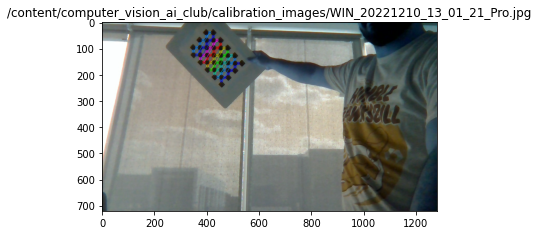

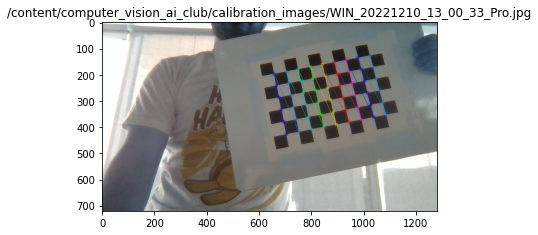

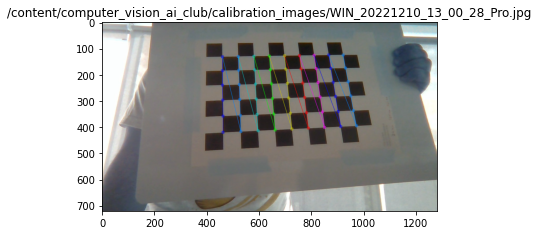

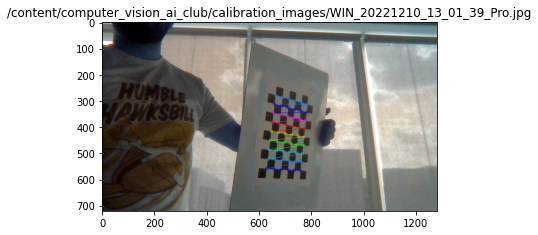

In [96]:
for filename in images:
    image = cv2.imread(filename)
    grayColor = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Find the chess board corners
    # If desired number of corners are
    # found in the image then ret = true
    ret, corners = cv2.findChessboardCorners(grayColor, CHECKERBOARD,
                                             cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_FAST_CHECK + cv2.CALIB_CB_NORMALIZE_IMAGE)

    # If desired number of corners can be detected then,
    # refine the pixel coordinates and display
    # them on the images of checker board
    if ret == True:
        threedpoints.append(objectp3d)
 
        # Refining pixel coordinates
        # for given 2d points.
        corners2 = cv2.cornerSubPix(grayColor, corners, (6, 6), (-1, -1), criteria)
        twodpoints.append(corners2)
        # Draw and display the corners
        image = cv2.drawChessboardCorners(image,CHECKERBOARD,corners2, ret)
 
    plt.imshow(image), plt.title(filename), plt.show()



In [ ]:
print("provided images count: ",len(images))
print("detected images count: ",len(twodpoints))

print(len(twodpoints[0]))
print(type(threedpoints[0]))
print((threedpoints[1]))

In [101]:

h, w = image.shape[:2]
print(h,w)

 
# Perform camera calibration by
# passing the value of above found out 3D points (threedpoints)
# and its corresponding pixel coordinates of the
# detected corners (twodpoints)
ret, matrix, distortion, r_vecs, t_vecs = cv2.calibrateCamera(threedpoints, twodpoints, grayColor.shape[::-1], None, None)
 
 
# Displaying required output
print(" Camera matrix:")
print(matrix)
 
print("\n Distortion coefficient:")
print(distortion)
 
print("\n Rotation Vectors:")
print(r_vecs)
 
print("\n Translation Vectors:")
print(t_vecs)


720 1280
 Camera matrix:
[[962.02019873   0.         671.93331796]
 [  0.         963.98430612 372.00276033]
 [  0.           0.           1.        ]]

 Distortion coefficient:
[[ 0.02780381 -0.19471598  0.00146951 -0.00074797  0.27224599]]

 Rotation Vectors:
(array([[ 0.05987003],
       [-0.19312493],
       [-1.4899766 ]]), array([[-0.24643822],
       [ 0.72503993],
       [-1.12634123]]), array([[ 0.01969327],
       [-0.7855283 ],
       [ 2.99772458]]), array([[ 0.52275028],
       [-0.35592401],
       [-3.04296282]]), array([[-0.07211919],
       [ 0.67048002],
       [-2.48805507]]), array([[-0.42265987],
       [ 0.44056491],
       [ 1.62746869]]), array([[ 0.08896576],
       [-0.96835784],
       [-2.35778337]]), array([[0.98463388],
       [0.34688119],
       [2.87343601]]), array([[ 0.02623518],
       [-0.28905953],
       [-1.41094209]]), array([[ 0.20944407],
       [-0.45391529],
       [-1.7333735 ]]), array([[-0.33859392],
       [ 0.55908756],
       [-1.99016

In [102]:
def draw(img, corners, imgpts):
    corner = tuple(corners[0].ravel())
    img = cv2.line(img, (int(corner[0]), int(corner[1])), tuple(imgpts[0].astype(int).ravel()), (255,0,0), 5)
    img = cv2.line(img, (int(corner[0]), int(corner[1])), tuple(imgpts[1].astype(int).ravel()), (0,255,0), 5)
    img = cv2.line(img, (int(corner[0]), int(corner[1])), tuple(imgpts[2].astype(int).ravel()), (0,0,255), 5)
    return img

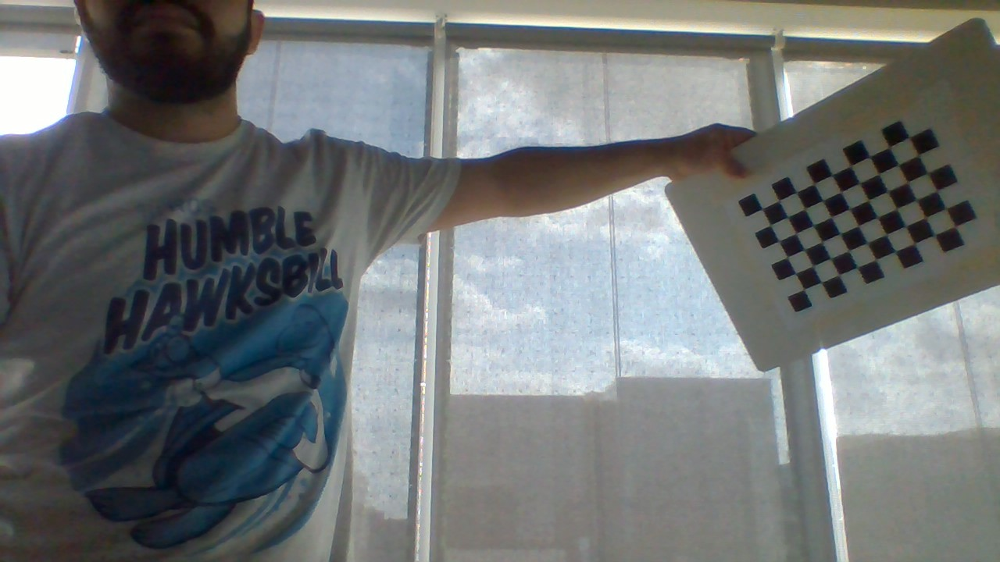

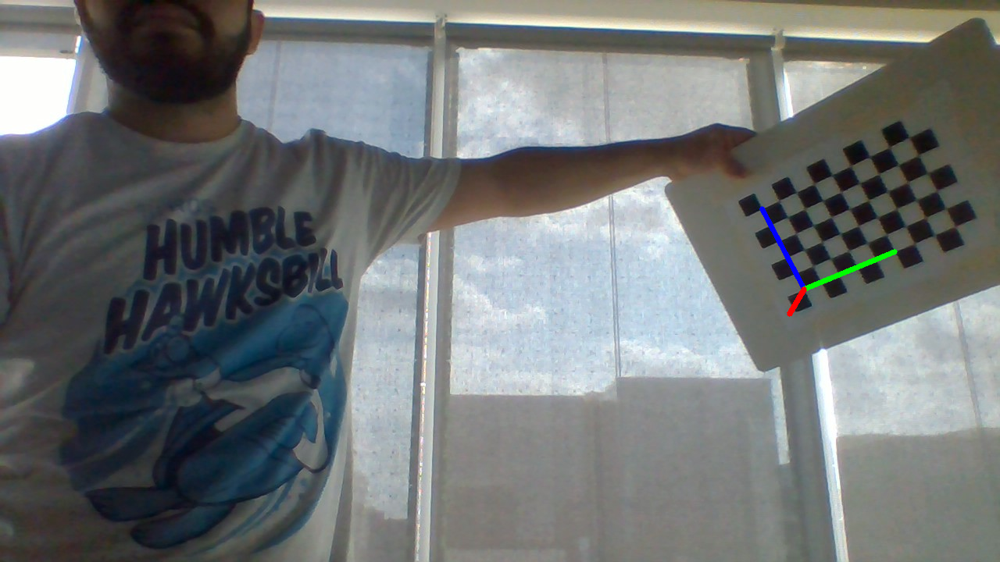

[[-0.33687158]
 [ 0.56221153]
 [-1.99000142]] [[ 0.3698838 ]
 [-0.00139868]
 [ 0.99639338]]


In [108]:


img = cv2.imread(images[10])
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
ret, corners = cv2.findChessboardCorners(gray, CHECKERBOARD ,None)
# print(corners)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
objp3d = np.zeros((CHECKERBOARD[0]* CHECKERBOARD[1],3), np.float32)
objp3d[:, :2] = np.mgrid[0:CHECKERBOARD[0],0:CHECKERBOARD[1]].T.reshape(-1, 2)
objp3d = objp3d * 0.024
axis = np.float32([[0.024*5,0,0], [0,0.024*5,0], [0,0,-0.024*5]]).reshape(-1,3)
cv2_imshow(img)
if ret == True:
    corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
    # Find the rotation and translation vectors.
    ret,rvecs, tvecs = cv2.solvePnP(objp3d, corners2, matrix, distortion)
    # project 3D points to image plane
    imgpts, jac = cv2.projectPoints(axis, rvecs, tvecs, matrix, distortion)
    img = draw(img,corners2,imgpts)
    cv2_imshow(img)
print(rvecs, tvecs)

# Aruco Marker Detection

[opencv tutorial](https://docs.opencv.org/4.x/d5/dae/tutorial_aruco_detection.html)

In [138]:
# define an empty custom dictionary for markers of size 4
aruco_dict = cv2.aruco.custom_dictionary(0, 4, 1)

# add empty bytesList array to fill with 3 markers later
aruco_dict.bytesList = np.empty(shape = (3, 2, 4), dtype = np.uint8)
marker1_array = [[1,0,1,1]
                ,[0,1,0,1]
                ,[0,0,1,1]
                ,[0,0,1,0]];
mybits = np.array(marker1_array, dtype = np.uint8)
aruco_dict.bytesList[0] = cv2.aruco.Dictionary_getByteListFromBits(mybits)

# add new marker(s)
mybits = np.array(marker1_array, dtype = np.uint8)
marker2_array = [[1,0,0,0]
                ,[0,1,1,0]
                ,[1,0,0,0]
                ,[1,0,1,1]];
mybits = np.array(marker2_array, dtype = np.uint8)
aruco_dict.bytesList[1] = cv2.aruco.Dictionary_getByteListFromBits(mybits)

# add new marker(s)
marker3_array = [[1,0,0,0]
                ,[1,0,0,0]
                ,[1,0,0,0]
                ,[1,0,0,0]];
mybits = np.array(marker3_array, dtype = np.uint8)
aruco_dict.bytesList[2] = cv2.aruco.Dictionary_getByteListFromBits(mybits)
# add new marker(s)


In [140]:
import cv2
import numpy as np

# Read the input image
images_PATH = "/content/computer_vision_ai_club/slides_images/"
img = cv2.imread(images_PATH + "aruco_id0.jpg")
if img is not None:
  # Convert the image to grayscale
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

  # Set the dictionary of 4x4 generic Aruco markers
  # aruco_dict = cv2.aruco.Dictionary_get(cv2.aruco.DICT_4X4_50)

  # Detect the Aruco markers in the image
  aruco_params = cv2.aruco.DetectorParameters_create()
  (corners, ids, rejected) = cv2.aruco.detectMarkers(img, aruco_dict,parameters=aruco_params)
  # Loop through all detected markers
  print(ids)
  print(corners)

[[0]]
(array([[[585., 132.],
        [777., 144.],
        [772., 334.],
        [580., 328.]]], dtype=float32),)


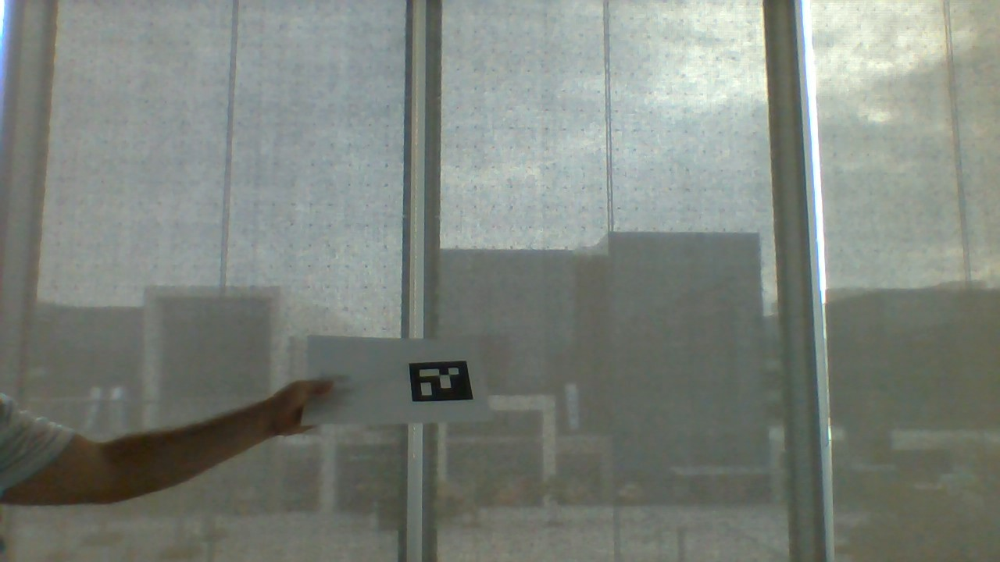

[[1]]


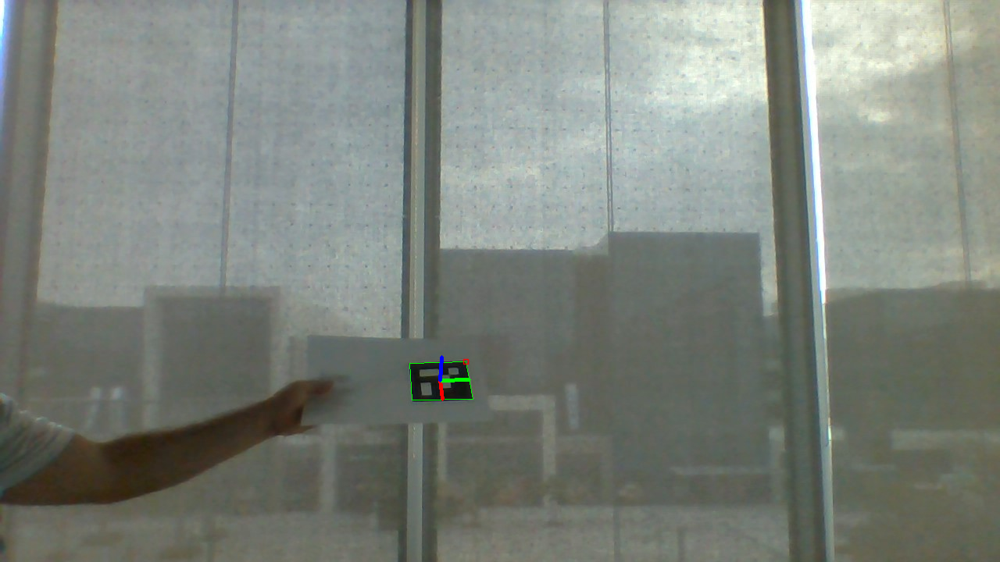

[[1]]


In [146]:
img = cv2.imread(images_PATH + "aruco_id20.jpg")
cv2_imshow(img)
Marker_Length = 0.1 # 0.1 m and 10 cm and 100 mm
corners, ids, rejected_img_points = cv2.aruco.detectMarkers(img, aruco_dict,parameters=aruco_params)
print(ids)
if ids is not None:
  for i in range(0, len(ids)):
      rvec, tvec, markerPoints = cv2.aruco.estimatePoseSingleMarkers(corners[i], Marker_Length, matrix, distortion)
      cv2.aruco.drawDetectedMarkers(img, corners) 
      cv2.drawFrameAxes(img,matrix,distortion,rvec,tvec,0.05)
      # cv2.aruco.drawDetectedMarkers(img, matrix, distortion, rvec, tvec, 0.01)
cv2_imshow(img)
print(ids)

# OpenCV python tutorials and projects on youtube

[opencv feature detection tutorials](https://docs.opencv.org/3.4/db/d27/tutorial_py_table_of_contents_feature2d.html)

[Nicolai Nielsen - Computer Vision & AI youtube channel](https://www.youtube.com/playlist?list=PLkmvobsnE0GEo-D7DLnrYS1K4OemycX6k)

[ComputerVision github repo](https://github.com/niconielsen32/ComputerVision)


# Harris feature extraction
Harris feature extraction is a method used in computer vision to detect corners and other interest points in images. It works by finding the local maxima of the cornerness function, which measures how "corner-like" a point in an image is. This method is often used in combination with other feature detection algorithms, such as SIFT or SURF, to provide more robust and accurate interest point detection.

[opencv explination](https://docs.opencv.org/3.4/dc/d0d/tutorial_py_features_harris.html)

### [How to implement](https://www.geekering.com/programming-languages/python/brunorsilva/harris-corner-detector-python/)
1. Calculate image x and y derivatives. ...
2. Derivate again the previous values to obtain the second derivative;
3. For each pixel, sum the last step obtained derivatives. ...
4. For each pixel and using the sums of the previous step, define H matrix;
5. Calculate the response of the detector;




Harris Features - Image 1


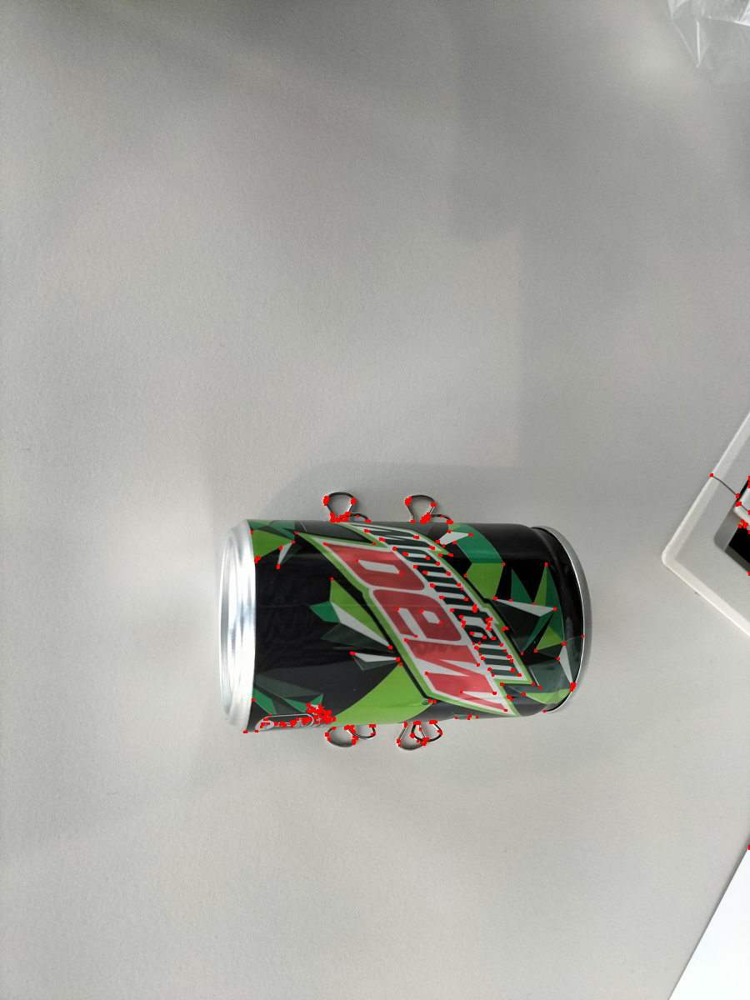

Harris Features - Image 2


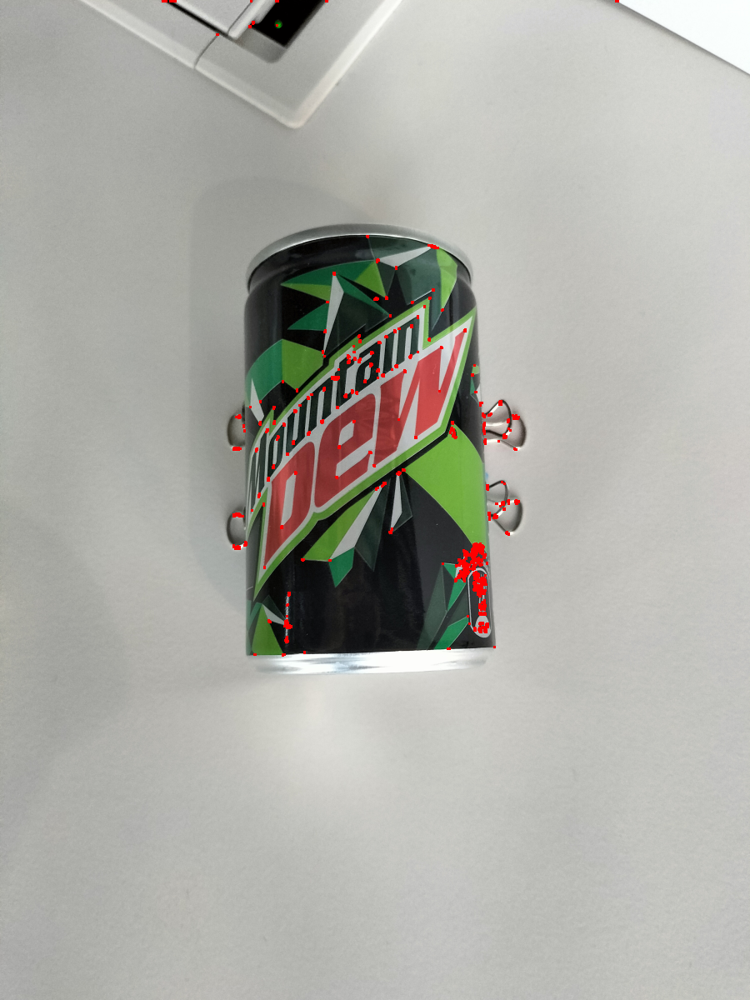

In [158]:
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
images_PATH = "/content/computer_vision_ai_club/slides_images/"
scale_percent = 30 # percent of original size
# read in the two images
img1 = cv2.imread(images_PATH + 'matching_1.jpg')
width = int(img1.shape[1] * scale_percent / 100)
height = int(img1.shape[0] * scale_percent / 100)
dim = (width, height)
# resize image
img1 = cv2.resize(img1, dim, interpolation = cv2.INTER_AREA)

img2 = cv2.imread(images_PATH + 'matching_3.jpg') 
width = int(img2.shape[1] * scale_percent / 100)
height = int(img2.shape[0] * scale_percent / 100)
dim = (width, height)
# resize image
img2 = cv2.resize(img2, dim, interpolation = cv2.INTER_AREA)

# convert the images to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray1 = np.float32(gray1)

gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
gray2 = np.float32(gray2)

# perform Harris feature extraction on the images
harris1 = cv2.cornerHarris(gray1, 2, 3, 0.04)
harris2 = cv2.cornerHarris(gray2, 2, 3, 0.04)
dst1 = cv2.cornerHarris(gray1,2,3,0.04)
dst2 = cv2.cornerHarris(gray2,2,3,0.04)

#result is dilated for marking the corners, not important
harris1 = cv2.dilate(harris1,None)
harris2 = cv2.dilate(harris2,None)
# Threshold for an optimal value, it may vary depending on the image.
img1[harris1>0.01*harris1.max()]=[0,0,255]
img2[harris2>0.01*harris2.max()]=[0,0,255]
# show the Harris feature maps for each image
print("Harris Features - Image 1")
cv2_imshow(img1)
print("Harris Features - Image 2")
cv2_imshow(img2)


# SIFT (Scale-invariant feature transform)

SIFT (Scale-invariant feature transform) is a computer vision algorithm used for extracting informative local features from images. These features are typically used for object recognition, image alignment, and other tasks that require identifying key points in an image. SIFT is scale-invariant, meaning it is able to detect and match features across different scales, allowing it to be robust to changes in viewpoint and lighting conditions.





In [166]:
import cv2 
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

#sift
sift = cv2.SIFT_create()

#feature matching
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

images_PATH = "/content/computer_vision_ai_club/slides_images/"

img1 = cv2.imread(images_PATH + 'matching_1.jpg')
img2 = cv2.imread(images_PATH + 'matching_5.jpg')

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)
img3 = cv2.drawMatches(img1, keypoints_1, img2, keypoints_2, matches[:600], img2, flags=2)
cv2_imshow( img3)


#object detection using HoG & SVM 

[Support Vector Machines (SVM) opencv tutorials](https://docs.opencv.org/4.x/d3/d02/tutorial_py_svm_index.html)

[HoG tutorial website](https://www.analyticsvidhya.com/blog/2019/09/feature-engineering-images-introduction-hog-feature-descriptor/#:~:text=The%20HOG%20feature%20descriptor%20counts,called%20hog%20in%20the%20skimage.)
![HoG image](https://cdn.analyticsvidhya.com/wp-content/uploads/2019/08/hog-feature.jpg)



In [169]:
import cv2
from google.colab.patches import cv2_imshow
from skimage.feature import hog

# read in the image
scale_percent = 20
img = cv2.imread("/content/human.jpg")
width = int(img.shape[1] * scale_percent / 100)
height = int(img.shape[0] * scale_percent / 100)
dim = (width, height)
# resize image
img = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)

#creating hog features 
fd, hog_image = hog(img, orientations=9, pixels_per_cell=(8, 8), 
                    cells_per_block=(2, 2), visualize=True, multichannel=True)
print(fd)

[0.25207464 0.04398264 0.         ... 0.11090906 0.10660534 0.        ]


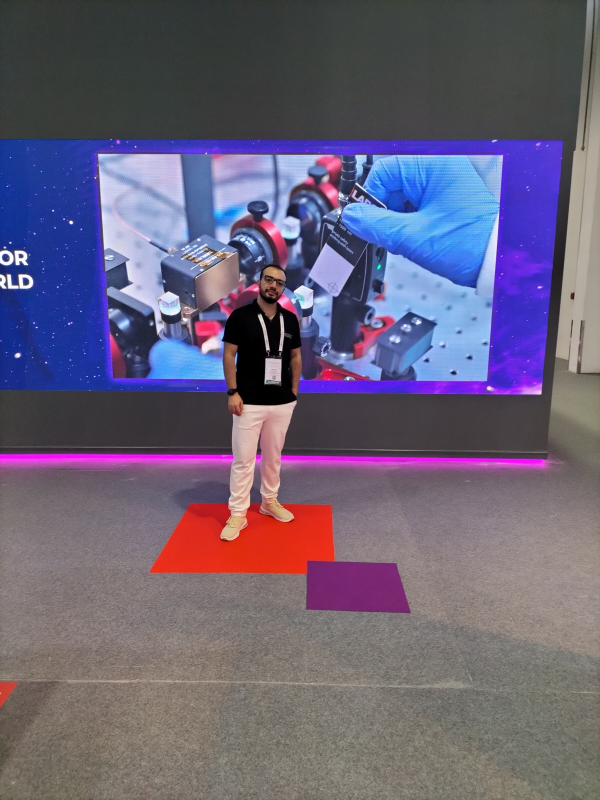

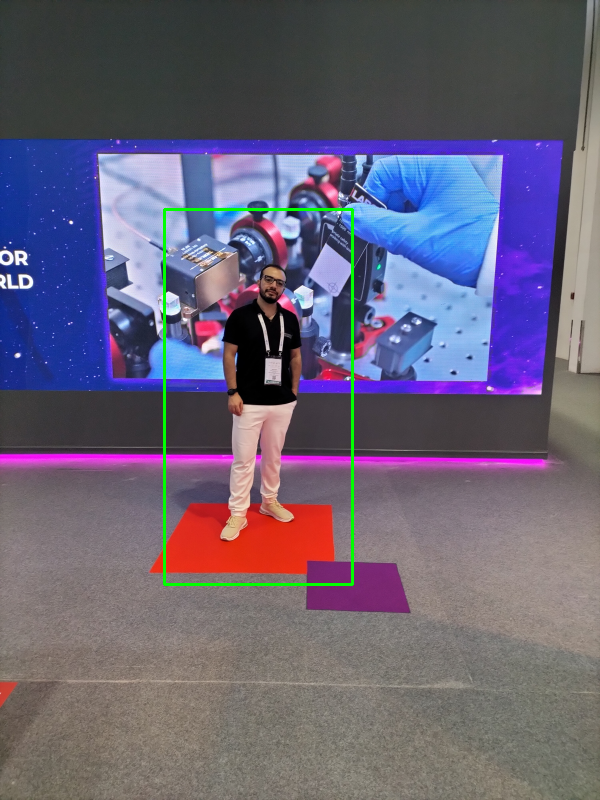

In [165]:
import cv2
from google.colab.patches import cv2_imshow

# read in the image
scale_percent = 20
img = cv2.imread("/content/human.jpg")
width = int(img.shape[1] * scale_percent / 100)
height = int(img.shape[0] * scale_percent / 100)
dim = (width, height)
# resize image
img = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)
cv2_imshow( img)
# convert the image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# create a HOG descriptor
hog = cv2.HOGDescriptor()

# set the SVM classifier
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())

# detect people in the image
(rects, weights) = hog.detectMultiScale(gray)

# loop over the detected people
for (x, y, w, h) in rects:
    # draw a bounding box around the person
    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

# show the output image
cv2_imshow( img)